In [1]:
import numpy as np
import pandas as pd
import xgboost as xgb
import seaborn as sns
import matplotlib.pyplot as plt
from hyperopt import fmin, tpe, hp, Trials, space_eval
from sklearn.metrics import mean_squared_error
from util import evaluate, plot_importance, plot_history
from sklearn.model_selection import train_test_split#安装库运行环境先百度清华镜像，清华镜像下载速度较快

In [2]:
data = pd.read_csv(r"G:\数据准备\建成环境\北京市\建成环境计算结果2\北京1.csv")

In [3]:
cols = ['build_buguize', 'avg_height', 'shape_coefficient_sum', 'jiaochakou', 'mean_kuai', 'shape_index',
             'TotalDensity', 'duanbofushe', 'rizhaodanweishu', 'wendu', 'gdp', 'dengguang', 'ndvi', 'mean_SVF',
             'zuigaoqiwen', 'ydl', 'beijing_LD_midu', 'beijing_SY_midu', 'beijing_TCC_midu', 'poi_hhd', 'p_cd',
             'p_gyyd', 'p_gggl', 'p_gc', 'p_jt', 'p_ld', 'p_nd', 'p_sl', 'p_sy', 'p_sd', 'p_st', 'p_zzyd',
             'landuse_hhd', 'road_density', 'bus_coverage_area', 'subway_coverage_area', 'floor_area_ratio']#选择的自变量
X = data[cols]
y = data['value_x']

In [4]:
# 定义名字映射
name_mapping = {
    'beijing_GF_midu': 'DPSF',
    'beijing_JT_midu': 'DTF',
    'beijing_JZ_midu': 'DRB',
    'beijing_LD_midu': 'DGF',
    'beijing_SY_midu': 'DCF',
    'beijing_TCC_midu': 'PLD',
    'poi_hhd': 'MUOI',
    'road_density': 'RD',
    'population_density': 'DP',
    'bus_coverage_area': 'BCM',
    'subway_coverage_area': 'SSCM',
    'building_density': 'BD',
    'floor_area_ratio': 'FAR',
    'p_cd': 'GF',
    'p_gyyd': 'PGF',
    'p_gggl': 'AF',
    'p_gc': 'SF',
    'p_jt': 'TSF',
    'p_ld': 'BLF',
    'p_nd': 'CF',
    'p_sl': 'FF',
    'p_sy': 'CSF',
    'p_sd': 'WF',
    'p_st': 'WBF',
    'p_zzyd': 'RF',
    'landuse_hhd': 'MULT',
    'ndvi': 'NDVI',
    'duanbofushe': 'ASWR',
    'fengsu': 'AMWP',
    'jiangshuiliang': 'AMPr',
    'pingjundiwen': 'AMGT',
    'qiya': 'AMPa',
    'rizhaodanweishu': 'AAS',
    'wendu': 'AMT',
    'shidu': 'AMRH',
    'zhengfaliang': 'AE',
    'build_buguize': 'BBI',
    'avg_height': 'MBH',
    'std_dev_height': 'SDBH',
    'shape_coefficient_sum': 'BSC',
    'jiaochakou': 'NRD',
    'shape_index': 'MSI',
    'TotalDensity': 'ED',
    'mean_SVF': 'SVF',
    'gdp': 'GDP',
    'zuigaoqiwen': 'AMMTmax',
    'zuidiqiwen': 'AMMTmin',
    'mean_kuai': 'PD',
    'dengguang': 'NLD',
    'ydl':'EC'
}

# 应用名字映射到data
data.rename(columns=name_mapping, inplace=True)

# 打印前几行检查新列名
print(data.head())

# 更新选择的自变量列名（如果需要）
cols_mapped = [name_mapping.get(col, col) for col in cols]  # 使用映射名称，如果没有映射则保留原名

# 提取更新后的自变量和因变量
X = data[cols_mapped]  # 这里使用更新后的列名
y = data['value_x']  # 因变量不需要重命名

# 打印X的列名以确认更新正确
print("更新后的X列名:", X.columns.tolist())

   aid  BBI  MBH  SDBH  BSC  NRD            PD        MSI        ED  \
0    0  0.0  0.0   0.0  0.0    0   1180.982208  39.531658  0.066332   
1    1  0.0  0.0   0.0  0.0    0   5441.326430  27.521125  0.049915   
2    2  0.0  0.0   0.0  0.0    2   4486.855136  70.095984  0.049819   
3    3  0.0  0.0   0.0  0.0    0  14861.924490  26.947743  0.035070   
4    4  0.0  0.0   0.0  0.0    1  12285.456860  48.826175  0.031756   

     value_x  ...  road_length         RD  population        DP       BCM  \
0  38.299999  ...     0.366359  25.851327           0  0.000000  0.000000   
1  38.599998  ...     1.167305  11.290836         143  1.383177  0.038382   
2  38.900002  ...     1.326249   6.568564          80  0.396219  0.658515   
3  38.799999  ...     0.177797   0.598162           0  0.000000  0.816347   
4  38.700001  ...     0.929877   2.365290         186  0.473120  1.736628   

       SSCM    wgarea   BD  building_area  FAR  
0  0.000000  0.014172  0.0            0.0  0.0  
1  0.000000 

In [5]:
X

,BBI,MBH,BSC,NRD,PD,MSI,ED,ASWR,AAS,AMT,...,FF,CSF,WF,WBF,RF,MULT,RD,BCM,SSCM,FAR
0,0.000000,0.000000,0.000000,0,1180.982208,39.531658,0.066332,5570.778723,2544.218833,13.335629,...,0.103698,0.0,0.0,0.00000,0.000000,0.360995,25.851327,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0,5441.326430,27.521125,0.049915,5570.778723,2544.218833,13.335629,...,0.342446,0.0,0.0,0.00000,0.331484,1.062250,11.290836,0.038382,0.000000,0.000000
2,0.000000,0.000000,0.000000,2,4486.855136,70.095984,0.049819,5570.778723,2544.218833,13.335629,...,0.239060,0.0,0.0,0.01608,0.485041,1.348557,6.568564,0.658515,0.033230,0.000000
3,0.000000,0.000000,0.000000,0,14861.924490,26.947743,0.035070,5570.778723,2544.218833,13.335629,...,0.113285,0.0,0.0,0.00000,0.009575,0.665761,0.598162,0.816347,0.297238,0.000000
4,0.000000,0.000000,0.000000,1,12285.456860,48.826175,0.031756,5570.778723,2544.218833,13.335629,...,0.053658,0.0,0.0,0.00000,0.000000,0.715195,2.365290,1.736628,0.393135,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
932,0.000000,0.000000,0.000000,1,6590.598858,7.766332,0.053631,5570.778723,2544.218833,13.335629,...,0.000000,0.0,0.0,0.00000,0.638019,0.580688,3.473759,0.050519,0.000000,0.000000
933,0.653157,26.953905,49.845906,2,30228.826330,37.674926,0.016337,5552.595215,2503.511230,13.171371,...,0.004066,0.0,0.0,0.00000,0.935172,0.414430,2.646915,0.058915,0.000000,0.206828
934,0.000000,0.000000,0.000000,1,11016.594740,12.852358,0.030125,5570.778723,2544.218833,13.335629,...,0.000000,0.0,0.0,0.00000,0.568416,0.839370,5.510022,0.125264,0.000000,0.000000
935,0.709614,27.976827,100.472464,0,24697.417820,38.756207,0.024305,5553.295898,2501.028076,13.225675,...,0.002187,0.0,0.0,0.00000,0.888563,0.499117,1.935215,1.155024,0.000000,0.427665


In [6]:
y

0      38.299999
1      38.599998
2      38.900002
3      38.799999
4      38.700001
         ...    
932    40.400002
933    41.099998
934    40.900002
935    41.299999
936    41.599998
Name: value_x, Length: 937, dtype: float64

In [7]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=42)#总数据分出0.2测试集和0.8训练集

In [8]:
X_train,X_valid,y_train,y_valid = train_test_split(X_train,y_train,test_size=0.2,random_state=42)#0.8的训练集分成0.2的训练集和0.8测试集

In [9]:
print('训练集大小:',X_train.shape[0])
print('测试集大小:',X_test.shape[0])
print('验证集大小:',X_valid.shape[0])

训练集大小: 599
测试集大小: 188
验证集大小: 150


In [10]:
param_space = {
    "max_depth": hp.choice("max_depth", np.linspace(1, 10, 10, dtype=int)),#2是最小，10是最大，9是分9份。此参数为学习深度默认值6典型最终值3-10
    "gamma": hp.choice("gamma", np.linspace(0.01, 1, 10)),#默认值为0使算法保守根据损失函数变化进行调整
    "n_estimators": hp.choice("n_estimators", np.linspace(1, 500, 500, dtype=int)),#最后是分多少份，迭代可以增加平线长度使得测试集和训练集更加贴近，老师修改的4000
    "colsample_bytree": hp.choice("colsample_bytree", np.linspace(0.5, 1, 10)),#减慢学习速度方法通过子样本和这个减少样本数和特征，让数值更小典型最终值0.5-1
    "subsample": hp.quniform("subsample", 0.5, 0.7, 0.1),#使算法更加保守，防治过拟合，太小的值会欠拟合。典型最终值0.5-1
    "eta": hp.uniform("eta", 0.01, 0.2),#学习率可以放慢学习速度，限制集合中每棵树的贡献默认值0.3，可以尝试较小的值0.01，典型最终值0.01-0.2
    "objective": "reg:squarederror",
    "eval_metric": "rmse",
    "random_state": 0
}

In [11]:
def score(params):
    model = xgb.XGBRegressor(**params)
    model.fit(X_train, y_train,#可以修改为训练集、测试集、验证集，寻找最佳参数的某个值
              eval_set=[(X_train, y_train), (X_valid, y_valid)],
              early_stopping_rounds=10,
              verbose=False)
    y_pred = model.predict(X_valid)
    score = mean_squared_error(y_valid, y_pred)
    return {"loss": score, "status": "ok"}

In [12]:
trials = Trials()
best_params_loc = fmin(score, param_space, algo=tpe.suggest, max_evals=200, trials=trials)
optimal_params = space_eval(param_space, best_params_loc)

  0%|          | 0/200 [00:00<?, ?trial/s, best loss=?]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  1%|          | 2/200 [00:00<00:47,  4.15trial/s, best loss: 1.8376590278822171]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  2%|▏         | 4/200 [00:00<00:39,  4.96trial/s, best loss: 1.6725732229422314]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  4%|▎         | 7/200 [00:01<00:30,  6.33trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  4%|▍         | 8/200 [00:01<00:36,  5.20trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  4%|▍         | 9/200 [00:01<00:34,  5.60trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  6%|▌         | 11/200 [00:02<00:32,  5.77trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  6%|▌         | 12/200 [00:02<00:37,  5.05trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  7%|▋         | 14/200 [00:02<00:36,  5.03trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  8%|▊         | 16/200 [00:03<00:32,  5.67trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



  8%|▊         | 17/200 [00:03<00:46,  3.94trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 10%|▉         | 19/200 [00:04<00:55,  3.28trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 10%|█         | 20/200 [00:04<00:52,  3.44trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 10%|█         | 21/200 [00:05<01:00,  2.97trial/s, best loss: 1.6535925623739567]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 12%|█▏        | 24/200 [00:05<00:43,  4.04trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 13%|█▎        | 26/200 [00:05<00:36,  4.82trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 14%|█▍        | 28/200 [00:06<00:31,  5.41trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 15%|█▌        | 30/200 [00:06<00:26,  6.37trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 16%|█▌        | 32/200 [00:06<00:30,  5.47trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 16%|█▋        | 33/200 [00:07<00:31,  5.33trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 18%|█▊        | 36/200 [00:07<00:25,  6.51trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 18%|█▊        | 37/200 [00:07<00:25,  6.35trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 20%|█▉        | 39/200 [00:08<00:39,  4.10trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 20%|██        | 40/200 [00:08<00:44,  3.57trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 21%|██        | 42/200 [00:09<00:39,  3.98trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 22%|██▏       | 43/200 [00:09<00:36,  4.29trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 22%|██▎       | 45/200 [00:09<00:32,  4.71trial/s, best loss: 1.5999199536898763]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 24%|██▎       | 47/200 [00:10<00:32,  4.73trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 24%|██▍       | 48/200 [00:10<00:36,  4.20trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 24%|██▍       | 49/200 [00:11<00:46,  3.23trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 25%|██▌       | 50/200 [00:11<00:46,  3.23trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 26%|██▌       | 52/200 [00:11<00:39,  3.73trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 26%|██▋       | 53/200 [00:12<00:37,  3.95trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 27%|██▋       | 54/200 [00:12<00:41,  3.49trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 28%|██▊       | 56/200 [00:12<00:36,  3.93trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 29%|██▉       | 58/200 [00:13<00:30,  4.71trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 30%|███       | 60/200 [00:13<00:27,  5.12trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 31%|███       | 62/200 [00:13<00:25,  5.31trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 32%|███▏      | 63/200 [00:14<00:25,  5.27trial/s, best loss: 1.5858547451177027]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 32%|███▎      | 65/200 [00:14<00:31,  4.28trial/s, best loss: 1.5835813646990309]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 33%|███▎      | 66/200 [00:15<00:33,  4.05trial/s, best loss: 1.5835813646990309]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 34%|███▎      | 67/200 [00:15<00:30,  4.41trial/s, best loss: 1.5835813646990309]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 34%|███▍      | 69/200 [00:15<00:24,  5.29trial/s, best loss: 1.5835813646990309]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 36%|███▌      | 71/200 [00:16<00:29,  4.41trial/s, best loss: 1.535437171065187] 

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 36%|███▌      | 72/200 [00:16<00:25,  5.10trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 37%|███▋      | 74/200 [00:16<00:23,  5.36trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 38%|███▊      | 76/200 [00:17<00:28,  4.41trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 38%|███▊      | 77/200 [00:17<00:26,  4.58trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 39%|███▉      | 78/200 [00:17<00:25,  4.78trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 40%|███▉      | 79/200 [00:17<00:28,  4.29trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 40%|████      | 81/200 [00:18<00:26,  4.41trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 42%|████▏     | 83/200 [00:18<00:27,  4.32trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 42%|████▎     | 85/200 [00:19<00:24,  4.68trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 44%|████▍     | 88/200 [00:19<00:17,  6.29trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 44%|████▍     | 89/200 [00:19<00:17,  6.20trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 46%|████▌     | 91/200 [00:19<00:17,  6.31trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 46%|████▌     | 92/200 [00:20<00:16,  6.57trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 46%|████▋     | 93/200 [00:20<00:18,  5.83trial/s, best loss: 1.535437171065187]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 48%|████▊     | 96/200 [00:20<00:18,  5.74trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 49%|████▉     | 98/200 [00:21<00:20,  5.09trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 50%|████▉     | 99/200 [00:21<00:20,  4.88trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 50%|█████     | 100/200 [00:21<00:24,  4.05trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 51%|█████     | 102/200 [00:22<00:21,  4.49trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 52%|█████▏    | 104/200 [00:22<00:18,  5.13trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 52%|█████▎    | 105/200 [00:22<00:16,  5.90trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 53%|█████▎    | 106/200 [00:23<00:23,  4.00trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 54%|█████▍    | 108/200 [00:23<00:25,  3.55trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 55%|█████▍    | 109/200 [00:24<00:23,  3.79trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 55%|█████▌    | 110/200 [00:24<00:20,  4.38trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 56%|█████▌    | 112/200 [00:24<00:18,  4.64trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 57%|█████▋    | 114/200 [00:25<00:22,  3.74trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 58%|█████▊    | 116/200 [00:25<00:21,  3.89trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 59%|█████▉    | 118/200 [00:26<00:18,  4.41trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 60%|█████▉    | 119/200 [00:26<00:16,  4.91trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 61%|██████    | 122/200 [00:26<00:11,  6.81trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 62%|██████▏   | 123/200 [00:26<00:13,  5.86trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 62%|██████▎   | 125/200 [00:27<00:14,  5.35trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 64%|██████▎   | 127/200 [00:27<00:12,  5.97trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 64%|██████▍   | 129/200 [00:27<00:11,  6.14trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 66%|██████▌   | 131/200 [00:28<00:20,  3.30trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 66%|██████▋   | 133/200 [00:29<00:15,  4.45trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 67%|██████▋   | 134/200 [00:29<00:15,  4.18trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 68%|██████▊   | 137/200 [00:30<00:14,  4.30trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 69%|██████▉   | 138/200 [00:30<00:15,  4.10trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 70%|███████   | 140/200 [00:31<00:15,  3.81trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 70%|███████   | 141/200 [00:31<00:20,  2.82trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 72%|███████▏  | 143/200 [00:32<00:16,  3.44trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 72%|███████▎  | 145/200 [00:32<00:12,  4.43trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 74%|███████▎  | 147/200 [00:32<00:10,  4.94trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 74%|███████▍  | 149/200 [00:33<00:11,  4.41trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 76%|███████▌  | 151/200 [00:33<00:10,  4.77trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 76%|███████▌  | 152/200 [00:33<00:09,  4.87trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 78%|███████▊  | 155/200 [00:34<00:08,  5.46trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 78%|███████▊  | 156/200 [00:34<00:07,  5.53trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 80%|███████▉  | 159/200 [00:35<00:06,  5.98trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 80%|████████  | 161/200 [00:35<00:05,  6.78trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 81%|████████  | 162/200 [00:35<00:05,  6.74trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 82%|████████▏ | 164/200 [00:35<00:05,  6.18trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 82%|████████▎ | 165/200 [00:36<00:06,  5.35trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 84%|████████▎ | 167/200 [00:36<00:07,  4.16trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 84%|████████▍ | 169/200 [00:37<00:06,  4.80trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 86%|████████▌ | 171/200 [00:37<00:05,  5.09trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 86%|████████▋ | 173/200 [00:37<00:05,  4.70trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 88%|████████▊ | 175/200 [00:38<00:04,  5.10trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 88%|████████▊ | 176/200 [00:38<00:04,  5.44trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 89%|████████▉ | 178/200 [00:38<00:04,  5.13trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 90%|█████████ | 180/200 [00:39<00:03,  5.19trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 90%|█████████ | 181/200 [00:39<00:04,  4.48trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 91%|█████████ | 182/200 [00:39<00:03,  4.85trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 92%|█████████▏| 184/200 [00:40<00:03,  5.06trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 93%|█████████▎| 186/200 [00:40<00:02,  6.66trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 94%|█████████▍| 188/200 [00:40<00:01,  7.53trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 94%|█████████▍| 189/200 [00:40<00:01,  5.70trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 96%|█████████▌| 191/200 [00:41<00:01,  5.23trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 96%|█████████▌| 192/200 [00:41<00:01,  4.82trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 97%|█████████▋| 194/200 [00:42<00:01,  4.13trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 98%|█████████▊| 195/200 [00:42<00:01,  4.79trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 98%|█████████▊| 197/200 [00:42<00:00,  4.56trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



 99%|█████████▉| 198/200 [00:42<00:00,  4.47trial/s, best loss: 1.4584841840541143]

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



100%|██████████| 200/200 [00:43<00:00,  4.64trial/s, best loss: 1.4584841840541143]


C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(



In [13]:
optimal_params#输出最佳参数

{'colsample_bytree': 0.8333333333333333,
 'eta': 0.16407514794140857,
 'eval_metric': 'rmse',
 'gamma': 0.23,
 'max_depth': 6,
 'n_estimators': 447,
 'objective': 'reg:squarederror',
 'random_state': 0,
 'subsample': 0.5}

# Fit on entire train and evaluate on test set

In [14]:
X_train = pd.concat([X_train, X_valid])
y_train = pd.concat([y_train, y_valid])

In [15]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)

In [16]:
model = xgb.XGBRegressor(**optimal_params)
model.fit(
    X_train, y_train,
    eval_set=[(X_train, y_train), (X_test, y_test), (X_valid, y_valid)],
    early_stopping_rounds=10,
    verbose=True
)

[0]	validation_0-rmse:2.58171	validation_1-rmse:2.66951	validation_2-rmse:2.61462
[1]	validation_0-rmse:2.31299	validation_1-rmse:2.45453	validation_2-rmse:2.29396
[2]	validation_0-rmse:2.10326	validation_1-rmse:2.29933	validation_2-rmse:2.07287
[3]	validation_0-rmse:1.92869	validation_1-rmse:2.14339	validation_2-rmse:1.88064
[4]	validation_0-rmse:1.77436	validation_1-rmse:2.02573	validation_2-rmse:1.71043
[5]	validation_0-rmse:1.64183	validation_1-rmse:1.93605	validation_2-rmse:1.57253
[6]	validation_0-rmse:1.53226	validation_1-rmse:1.87221	validation_2-rmse:1.48388
[7]	validation_0-rmse:1.43503	validation_1-rmse:1.80998	validation_2-rmse:1.38981
[8]	validation_0-rmse:1.35259	validation_1-rmse:1.76126	validation_2-rmse:1.31234
[9]	validation_0-rmse:1.26962	validation_1-rmse:1.70890	validation_2-rmse:1.23827
[10]	validation_0-rmse:1.20676	validation_1-rmse:1.68050	validation_2-rmse:1.17489
[11]	validation_0-rmse:1.14458	validation_1-rmse:1.65511	validation_2-rmse:1.12643
[12]	validatio

C:\ProgramData\anaconda3\Lib\site-packages\xgboost\sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


[18]	validation_0-rmse:0.85278	validation_1-rmse:1.54168	validation_2-rmse:0.91317
[19]	validation_0-rmse:0.81795	validation_1-rmse:1.53519	validation_2-rmse:0.86945
[20]	validation_0-rmse:0.79147	validation_1-rmse:1.52139	validation_2-rmse:0.84730
[21]	validation_0-rmse:0.75856	validation_1-rmse:1.52000	validation_2-rmse:0.82712
[22]	validation_0-rmse:0.73785	validation_1-rmse:1.50904	validation_2-rmse:0.82125
[23]	validation_0-rmse:0.71107	validation_1-rmse:1.50649	validation_2-rmse:0.80978
[24]	validation_0-rmse:0.68541	validation_1-rmse:1.50202	validation_2-rmse:0.80379
[25]	validation_0-rmse:0.67026	validation_1-rmse:1.50362	validation_2-rmse:0.78867
[26]	validation_0-rmse:0.64943	validation_1-rmse:1.50920	validation_2-rmse:0.76643
[27]	validation_0-rmse:0.63772	validation_1-rmse:1.51239	validation_2-rmse:0.75671
[28]	validation_0-rmse:0.62172	validation_1-rmse:1.50691	validation_2-rmse:0.73389
[29]	validation_0-rmse:0.61018	validation_1-rmse:1.50575	validation_2-rmse:0.71637
[30]

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8333333333333333, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eta=0.16407514794140857, eval_metric='rmse', feature_types=None,
             gamma=0.23, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=447, n_jobs=None,
             num_parallel_tree=None, ...)

In [17]:
Z = model.predict(data[cols_mapped])

xx = np.zeros(shape=(937,2))
xx[:,0]=data['value_x'].values
xx[:,1]=Z
np.savetxt('XGB.csv', xx, delimiter = ',') 

MAE = 0.1790944924473773
MSE = 0.05657529774118389
RMSE = 0.2378556237325153
MAPE = 0.004707734645529096
R^2 = 0.9930559484251518
Explained Variance Score = 0.9930626071087424

Residuals summary stats
╒═══════╤════════════╕
│ count │        655 │
├───────┼────────────┤
│ mean  │ 0.00736548 │
├───────┼────────────┤
│ std   │   0.237923 │
├───────┼────────────┤
│ min   │   -0.82888 │
├───────┼────────────┤
│ 25%   │  -0.128927 │
├───────┼────────────┤
│ 50%   │ 0.00650406 │
├───────┼────────────┤
│ 75%   │   0.139711 │
├───────┼────────────┤
│ max   │    1.09566 │
╘═══════╧════════════╛


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(



Deviation from mean of residuals
╒════════════╤══════════╤════════════╕
│ Interval   │   Actual │   Expected │
╞════════════╪══════════╪════════════╡
│ μ ± σ      │  71.7557 │       68.2 │
├────────────┼──────────┼────────────┤
│ μ ± 2σ     │  94.3511 │       95.4 │
├────────────┼──────────┼────────────┤
│ μ ± 3σ     │  98.7786 │       99.7 │
╘════════════╧══════════╧════════════╛

Jarque-Bera Test on Residuals
╒══════════════╤══════════════╕
│ JB-Statistic │ 63.8309      │
├──────────────┼──────────────┤
│ Chi2-P-value │  1.37817e-14 │
├──────────────┼──────────────┤
│ Skew         │  0.146778    │
├──────────────┼──────────────┤
│ Kurtosis     │  4.50089     │
╘══════════════╧══════════════╛


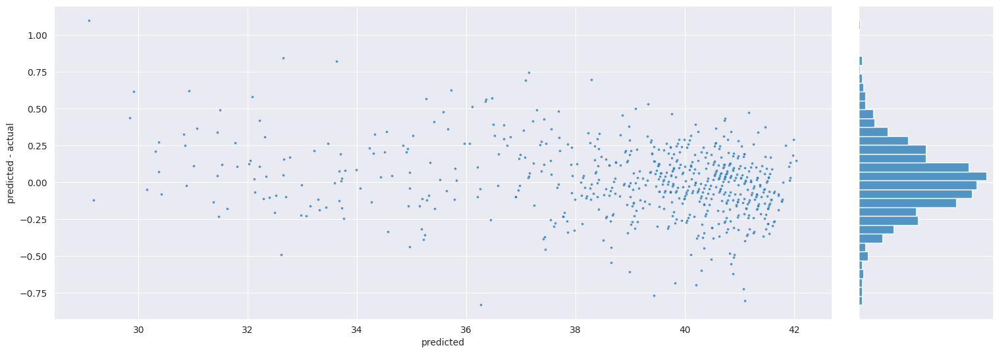

<Figure size 1000x800 with 0 Axes>

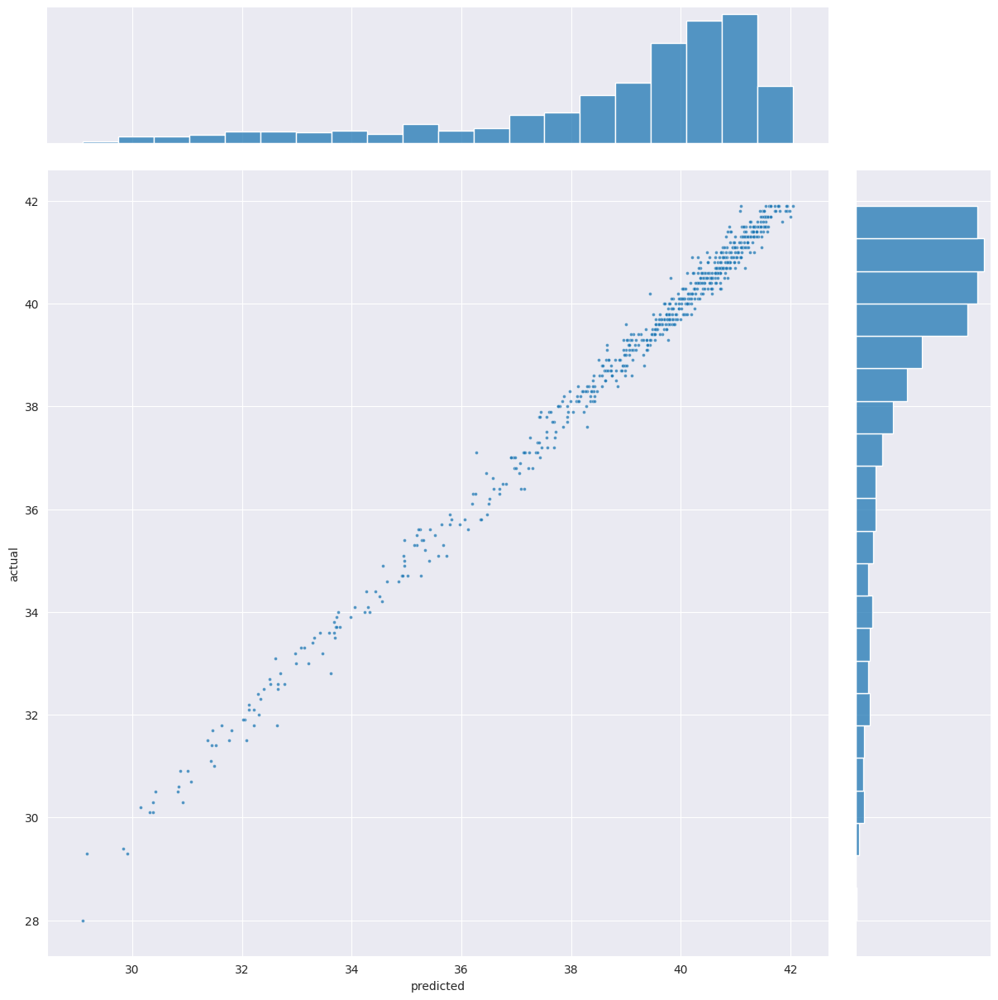

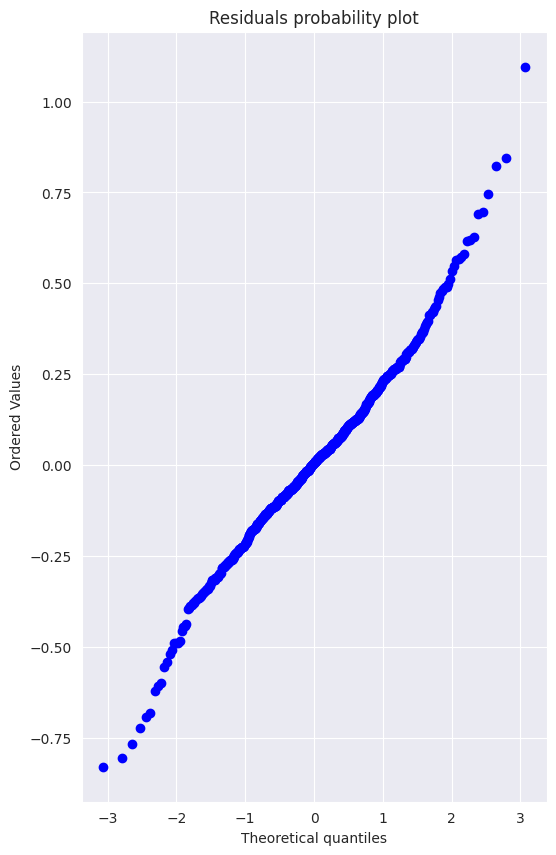

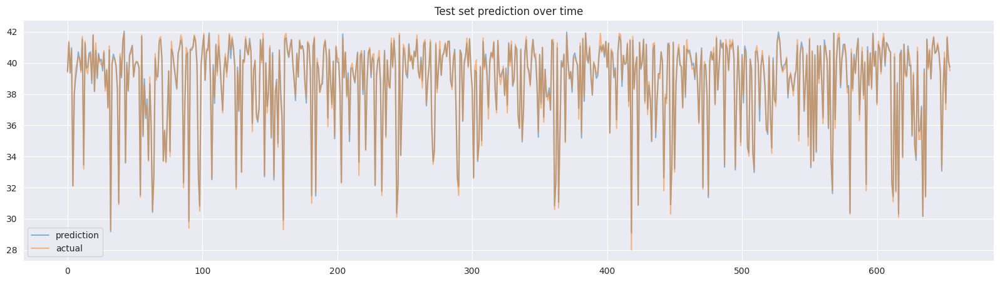

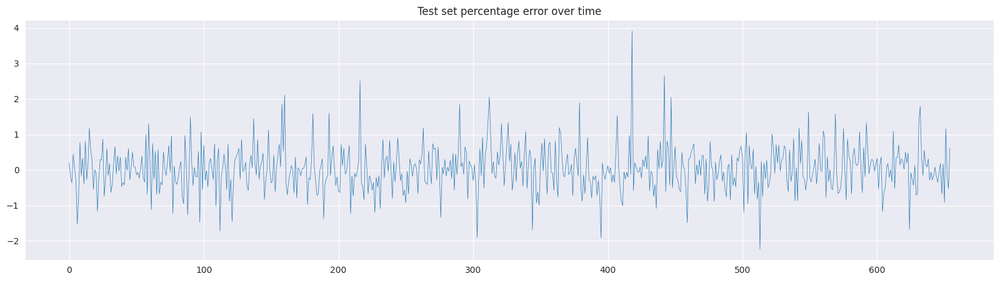

In [18]:
y_train_pred = model.predict(X_train)
evaluate(y_train.to_numpy(), y_train_pred)

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


MAE = 0.3029704034965818
MSE = 0.3032364733943651
RMSE = 0.5506691142549808
MAPE = 0.008123165462666811
R^2 = 0.964296215121633
Explained Variance Score = 0.964366253157727

Residuals summary stats
╒═══════╤═════════════╕
│ count │         150 │
├───────┼─────────────┤
│ mean  │   0.0243894 │
├───────┼─────────────┤
│ std   │    0.551972 │
├───────┼─────────────┤
│ min   │    -2.51483 │
├───────┼─────────────┤
│ 25%   │    -0.16094 │
├───────┼─────────────┤
│ 50%   │ -0.00168228 │
├───────┼─────────────┤
│ 75%   │    0.202311 │
├───────┼─────────────┤
│ max   │     3.32928 │
╘═══════╧═════════════╛

Deviation from mean of residuals
╒════════════╤══════════╤════════════╕
│ Interval   │   Actual │   Expected │
╞════════════╪══════════╪════════════╡
│ μ ± σ      │  88.6667 │       68.2 │
├────────────┼──────────┼────────────┤
│ μ ± 2σ     │  95.3333 │       95.4 │
├────────────┼──────────┼────────────┤
│ μ ± 3σ     │  97.3333 │       99.7 │
╘════════════╧══════════╧════════════╛

Jarque-B

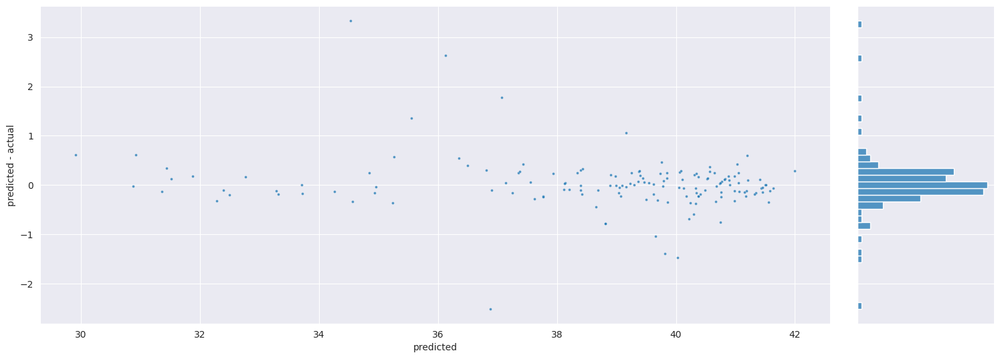

<Figure size 1000x800 with 0 Axes>

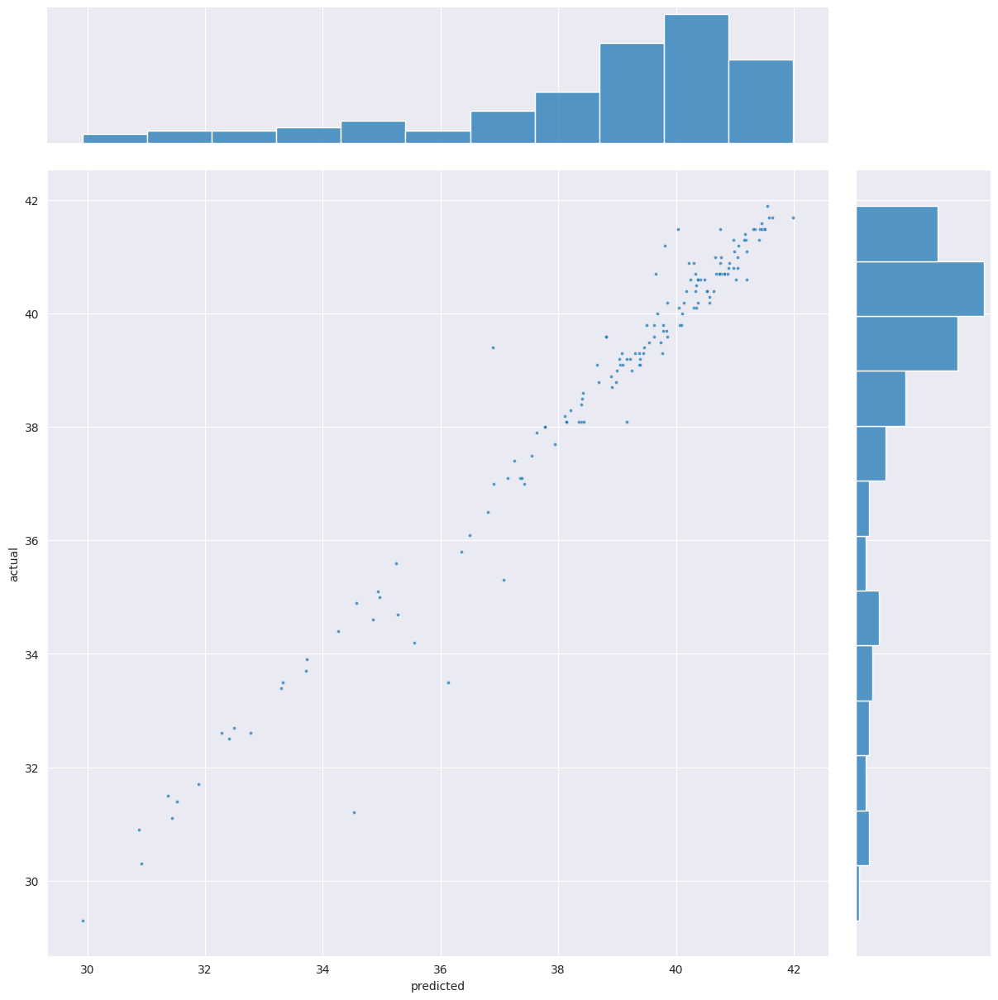

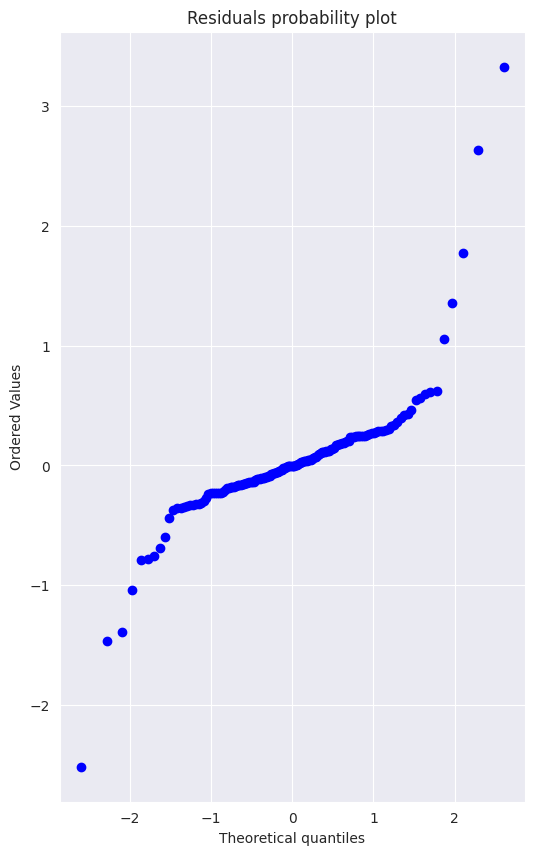

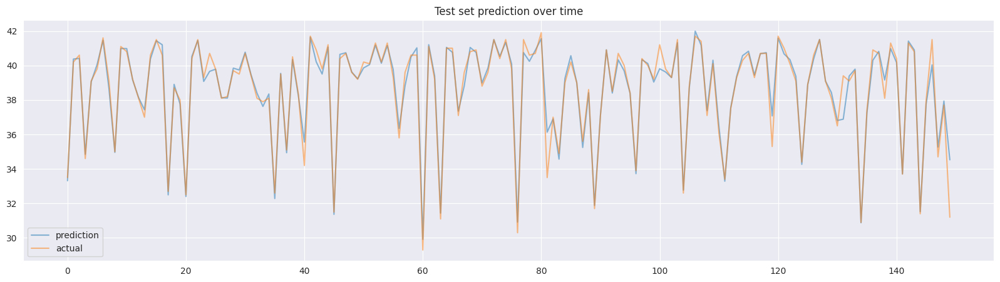

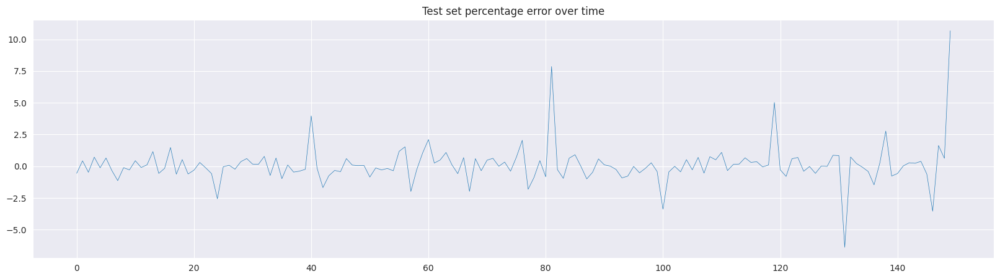

In [19]:
y_valid_pred = model.predict(X_valid)
evaluate(y_valid.to_numpy(), y_valid_pred)

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


MAE = 1.0184343623055705
MSE = 2.159474489160528
RMSE = 1.4695150523763028
MAPE = 0.02735900907308851
R^2 = 0.7474243553105562
Explained Variance Score = 0.7474292639831915

Residuals summary stats
╒═══════╤═════════════╕
│ count │         282 │
├───────┼─────────────┤
│ mean  │ -0.00647829 │
├───────┼─────────────┤
│ std   │     1.47211 │
├───────┼─────────────┤
│ min   │    -5.71533 │
├───────┼─────────────┤
│ 25%   │    -0.70514 │
├───────┼─────────────┤
│ 50%   │  -0.0249691 │
├───────┼─────────────┤
│ 75%   │     0.62912 │
├───────┼─────────────┤
│ max   │     6.00787 │
╘═══════╧═════════════╛

Deviation from mean of residuals
╒════════════╤══════════╤════════════╕
│ Interval   │   Actual │   Expected │
╞════════════╪══════════╪════════════╡
│ μ ± σ      │  78.0142 │       68.2 │
├────────────┼──────────┼────────────┤
│ μ ± 2σ     │  92.9078 │       95.4 │
├────────────┼──────────┼────────────┤
│ μ ± 3σ     │  98.9362 │       99.7 │
╘════════════╧══════════╧════════════╛

Jarque-B

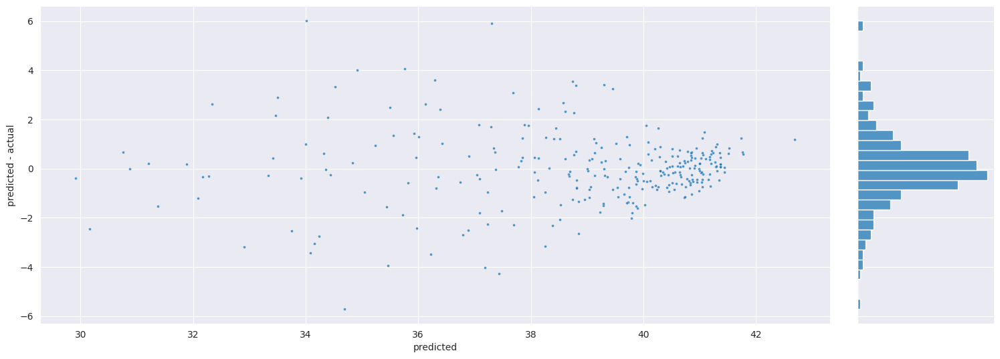

<Figure size 1000x800 with 0 Axes>

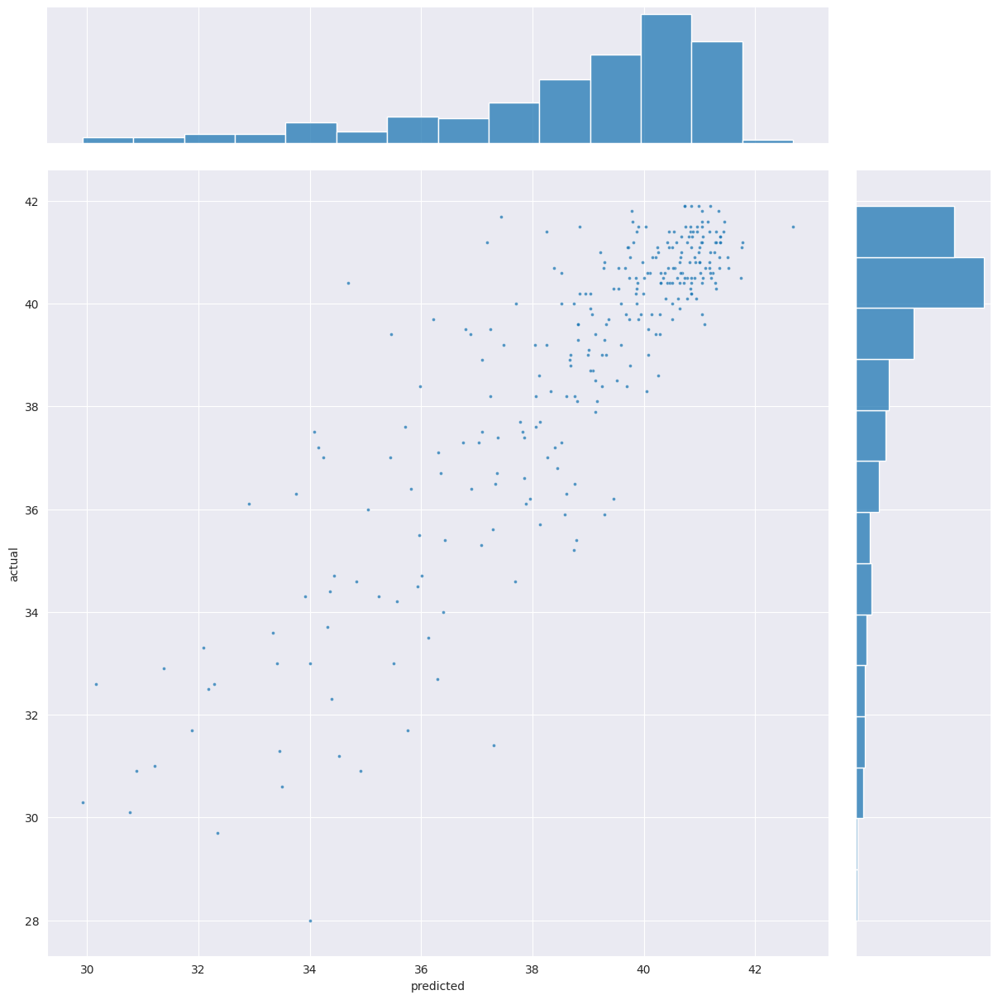

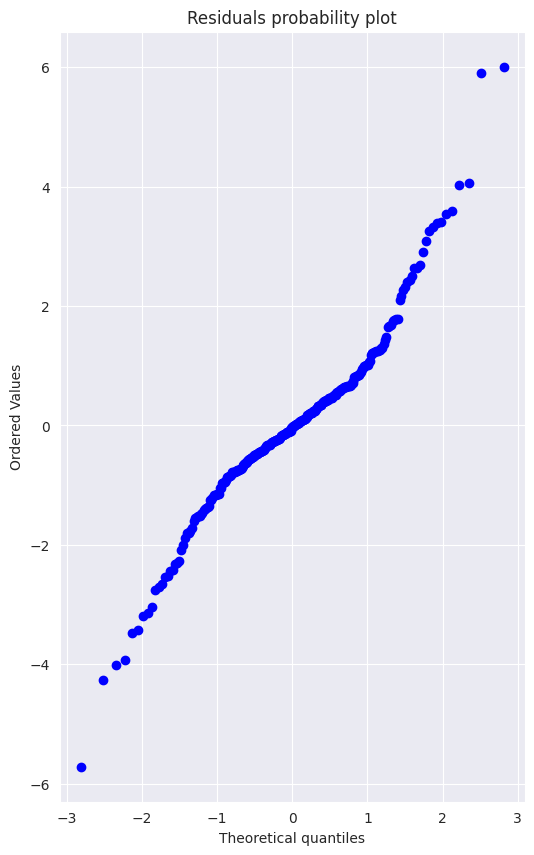

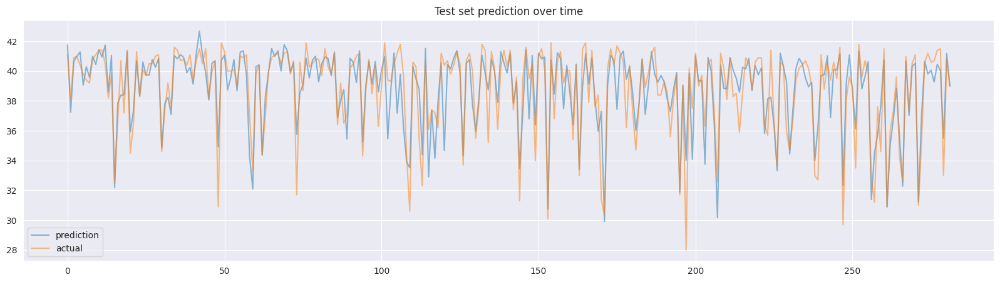

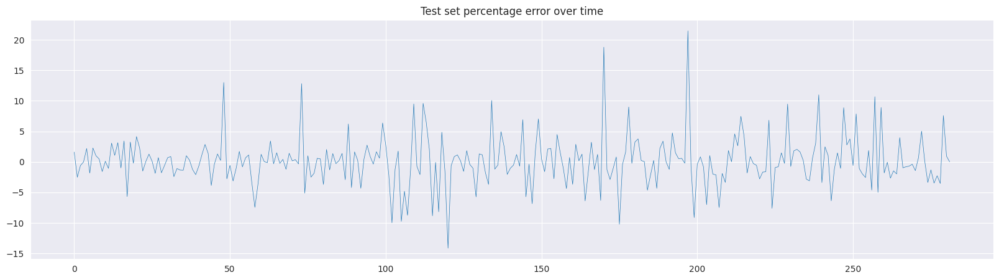

In [20]:
y_pred = model.predict(X_test)
evaluate(y_test.to_numpy(), y_pred)

In [21]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
# define an additional metric 
def MAPE(true, pred):
    diff = np.abs(np.array(true) - np.array(pred))
    return np.mean(diff / abs(true))

In [22]:
print("Training R2:", r2_score(y_train, y_train_pred), "traing RMSE:", np.sqrt(mean_squared_error(y_train, y_train_pred)), "training MAE:", mean_absolute_error(y_train, y_train_pred), "MAPE:", MAPE(y_train, y_train_pred)*100,"%")

Training R2: 0.9930559484251518 traing RMSE: 0.2378556237325153 training MAE: 0.1790944924473773 MAPE: 0.47077346455290964 %


In [23]:
print("Testing R2:", r2_score(y_test, y_pred), "Testing RMSE:", np.sqrt(mean_squared_error(y_test, y_pred)), "Testing MAE:", mean_absolute_error(y_test, y_pred), "MAPE:", MAPE(y_test, y_pred)*100,"%")

Testing R2: 0.7474243553105562 Testing RMSE: 1.4695150523763028 Testing MAE: 1.0184343623055705 MAPE: 2.735900907308851 %


In [24]:
print("Valid R2:", r2_score( y_valid, y_valid_pred), "valid RMSE:", np.sqrt(mean_squared_error(y_valid, y_valid_pred)), "Testing MAE:", mean_absolute_error(y_valid, y_valid_pred), "MAPE:", MAPE(y_valid, y_valid_pred)*100,"%")

Valid R2: 0.964296215121633 valid RMSE: 0.5506691142549808 Testing MAE: 0.3029704034965818 MAPE: 0.8123165462666811 %


In [25]:
import os
import numpy as np
import pandas as pd
import xgboost as xgb
import seaborn as sns
from tabulate import tabulate
import matplotlib.pyplot as plt
from scipy.stats import probplot
from statsmodels.stats.stattools import jarque_bera
from sklearn import metrics


def combine_data():
    data = []
    for file in sorted(os.listdir("pp_gas_emission")):
        df = pd.read_csv(f"./pp_gas_emission/{file}")
        df['year'] = int(file[3:7])
        data.append(df)
    df = pd.concat(data)
    df.drop_duplicates(inplace=True)
    df.reset_index(inplace=True, drop=True)
    df["target"] = df["TEY"].shift(-1)
    df.drop(df.tail(1).index, inplace=True)
    df.to_parquet("pp_gas_emission.parquet")


def evaluate(y_test, y_pred):
    mae = metrics.mean_absolute_error(y_test, y_pred)
    mse = metrics.mean_squared_error(y_test, y_pred)
    rmse = metrics.mean_squared_error(y_test, y_pred, squared=False)
    r2 = metrics.r2_score(y_test, y_pred)
    explained_var_score = metrics.explained_variance_score(y_test, y_pred)
    mape = metrics.mean_absolute_percentage_error(y_test, y_pred)
    print(f"MAE = {mae}")
    print(f"MSE = {mse}")
    print(f"RMSE = {rmse}")
    print(f"MAPE = {mape}")
    print(f"R^2 = {r2}")
    print(f"Explained Variance Score = {explained_var_score}")

    residuals = y_pred - y_test
    print("\nResiduals summary stats")
    print(tabulate(
        pd.Series(residuals).describe().to_frame(),
        numalign="right", tablefmt="fancy_grid",
    ))

    with sns.axes_style("darkgrid"):
        g = sns.jointplot(x=y_pred, y=y_pred-y_test, s=8, alpha=0.75, height=12)
        g.set_axis_labels('predicted', 'predicted - actual')
        g.fig.set_figwidth(15)
        g.fig.set_figheight(6)
        g.ax_marg_x._visible = False

        plt.figure(figsize=(10, 8))
        g = sns.jointplot(x=y_pred, y=y_test, s=8, alpha=0.75, height=12)
        g.set_axis_labels('predicted', 'actual')

        fig, ax = plt.subplots(1, 1, figsize=(6, 10))
        probplot(residuals, sparams=(0, 1), plot=ax, fit=False)
        ax.set_title("Residuals probability plot")

        plt.figure(figsize=(20, 5))
        plt.plot(y_pred, alpha=0.5, label="prediction")
        plt.plot(y_test, alpha=0.5, label="actual")
        plt.legend()
        plt.title("Test set prediction over time")
        
        plt.figure(figsize=(20, 5))
        plt.plot(100*(residuals)/y_test, linewidth=0.5)
        plt.title("Test set percentage error over time")
    
    res_mean = residuals.mean()
    res_std = residuals.std()

    one_std_condition = ((residuals >= res_mean - 1*res_std) & (residuals <= res_mean + 1*res_std))
    two_std_condition = ((residuals >= res_mean - 2*res_std) & (residuals <= res_mean + 2*res_std))
    three_std_condition = ((residuals >= res_mean - 3*res_std) & (residuals <= res_mean + 3*res_std))
    perc_within_one_std = 100*len(residuals[np.where(one_std_condition)])/len(residuals)
    perc_within_two_std = 100*len(residuals[np.where(two_std_condition)])/len(residuals)
    perc_within_three_std = 100*len(residuals[np.where(three_std_condition)])/len(residuals)

    print("\nDeviation from mean of residuals")
    print(tabulate(pd.DataFrame({
        "μ ± σ": {"actual": perc_within_one_std, "expected": 68.2},
        "μ ± 2σ": {"actual": perc_within_two_std, "expected": 95.4},
        "μ ± 3σ": {"actual": perc_within_three_std, "expected": 99.7},  
    }).T, headers=["Interval", "Actual", "Expected"], tablefmt="fancy_grid"))
    
    print("\nJarque-Bera Test on Residuals")
    result = jarque_bera(residuals)
    result_labels = ("JB-Statistic", "Chi2-P-value", "Skew", "Kurtosis")
    print(tabulate(list(zip(result_labels, result)), tablefmt="fancy_grid"))


def plot_importance(model):
    # with sns.set_style("whitegrid"):
    with plt.style.context('ggplot'):
        fig, axes = plt.subplots(1, 3, figsize=(18, 18))
        fig.tight_layout(pad=8)
        axes[0] = xgb.plot_importance(model, ax=axes[0],
                                      importance_type="weight",
                                      xlabel="weight")
        axes[1] = xgb.plot_importance(model, ax=axes[1],
                                      importance_type="gain",
                                      xlabel="gain")
        axes[2] = xgb.plot_importance(model, ax=axes[2],
                                      importance_type="cover",
                                      xlabel="cover")
        for ax, title in zip(axes, ["weight", "gain", "cover"]):
            ax.set_title(f"Features ranked by {title}")
            ax.set_ylabel(None)
            ax.tick_params(axis="x", labelsize=10)
            ax.tick_params(axis="y", labelsize=10)
            for txt_obj in ax.texts:
                curr_text = txt_obj.get_text()
                new_text = round(float(curr_text), 1)
                txt_obj.set_text(new_text)
    return


def plot_history(model):
    # with sns.set_style("whitegrid"):
    with plt.style.context('ggplot'):
        history = model.evals_result()
        fig, ax = plt.subplots(1, 1, figsize=(14, 5))
        ax.plot(range(len(history['validation_0']['rmse'])),
                history['validation_0']['rmse'],
                label="Training RMSE", linewidth=2)
        ax.plot(range(len(history['validation_1']['rmse'])),
                history['validation_1']['rmse'],
                label="Testing RMSE", linewidth=2)
        ax.set_title('RMSE')
        ax.grid(True)
        ax.legend()
    return


def rolling_means(df, window, min_periods, cols=None):
    cols = cols or df.columns.to_list()
    df_roll = (df[cols]
               .rolling(window, min_periods=min_periods)
               .mean()
               .fillna(df))
    df_roll.columns = df_roll.columns.map(lambda c: f"{c}_ROLL{window}_MEAN")
    return df_roll


def rolling_standard_deviation(df, window, min_periods, cols=None):
    cols = cols or df.columns.to_list()
    df_roll = (df[cols]
               .rolling(window, min_periods=min_periods)
               .std()
               .fillna(1))
    df_roll.columns = df_roll.columns.map(lambda c: f"{c}_ROLL{window}_STD")
    return df_roll


def lagged_features(df, lags, cols=None):
    if isinstance(lags, int):
        lags = range(1, lags+1)
    cols = cols or df.columns.to_list()
    data = []
    for lag in lags:
        lagged_data = df[cols].shift(lag).fillna(df)
        lagged_data.columns = lagged_data.columns.map(lambda c: f"{c}_LAG{lag}")
        data.append(lagged_data)
    return pd.concat(data, axis="columns")

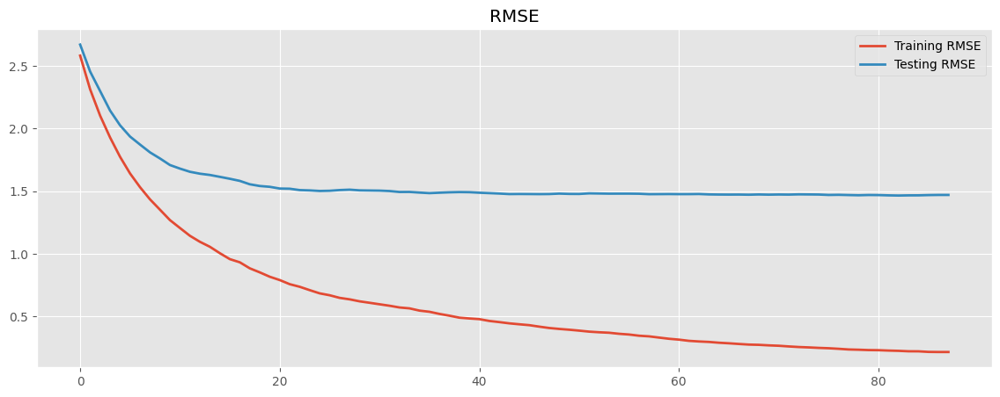

In [26]:
plot_history(model)

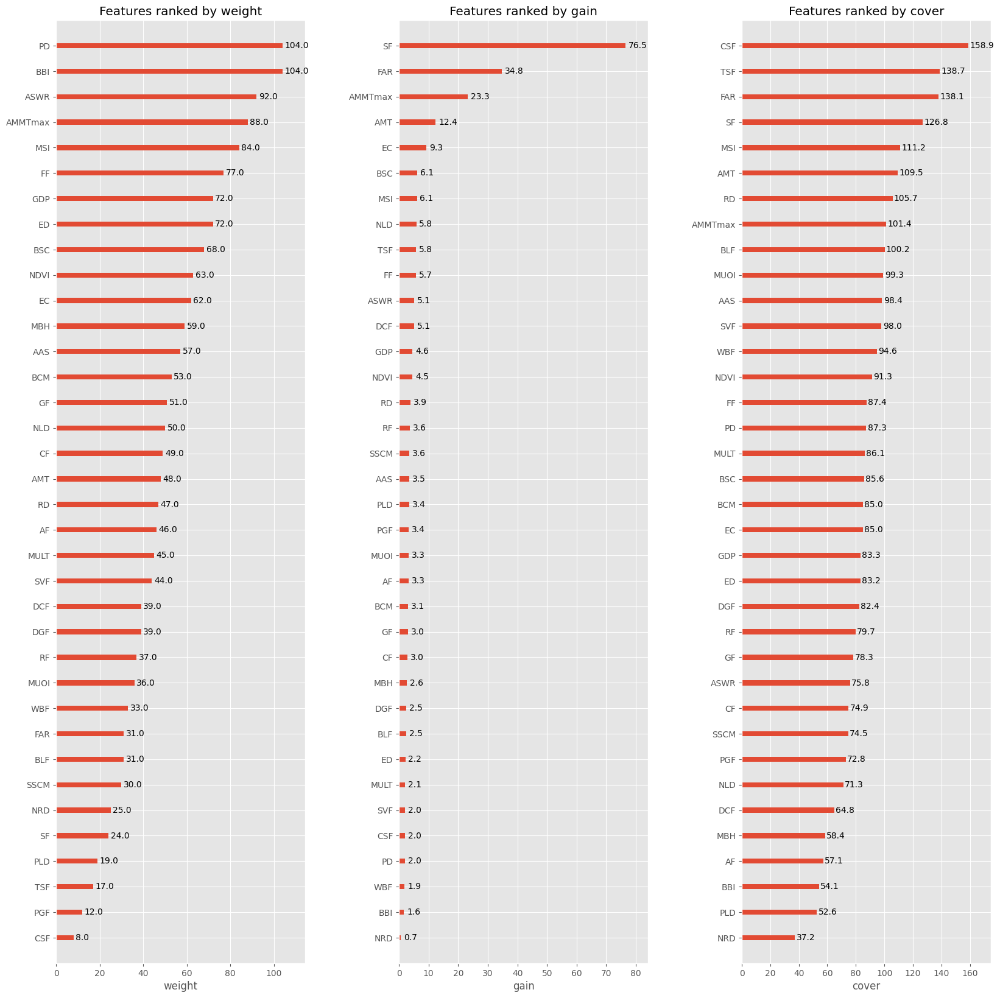

In [27]:
plot_importance(model)

In [28]:
import shap

In [29]:
cols = ['BBI', 'MBH', 'BSC', 'NRD', 'PD', 'MSI', 'ED', 'ASWR', 'AAS', 'AMT', 'GDP', 'NLD', 'NDVI', 'SVF', 'AMMTmax', 'EC', 'DGF', 'DCF', 'PLD', 'MUOI', 'GF', 'PGF', 'AF', 'SF', 'TSF', 'BLF', 'CF', 'FF', 'CSF', 'WF', 'WBF', 'RF', 'MULT', 'RD', 'BCM', 'SSCM', 'FAR']

In [30]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(data[cols])
print(shap_values.shape)
np.savetxt('shap values.csv', shap_values, delimiter = ',') 
y_base = explainer.expected_value
print(y_base)
data['pred'] = model.predict(data[cols])
print(data['pred'].mean())

(937, 37)
38.822803
38.83169


[20:12:08] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0750514818a16474a-1\xgboost\xgboost-ci-windows\src\c_api\c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


In [31]:
import matplotlib.gridspec as gridspec
# 设置全局字体和字号，确保不加粗
plt.rcParams.update({
    'font.family': 'Times New Roman',
    'font.size': 12,
    'axes.labelweight': 'normal',  # 确保轴标签不加粗
    'axes.titleweight': 'normal',  # 确保标题不加粗
})

# 假设shap_values, data和cols已经正确定义

# 创建一个新的figure和使用GridSpec进行布局
fig = plt.figure(figsize=(24, 8))  # 调整整个figure的大小
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2.5], wspace=0.5)  # 定义两个宽度不同的子图

# 第一个子图（SHAP summary plot）
ax1 = plt.subplot(gs[0])
shap.summary_plot(shap_values, data[cols], feature_names=data[cols].columns.tolist(), plot_type="dot", cmap="viridis", color_bar=False, show=False)
ax_main = plt.gca()
ax_main.yaxis.tick_right()
ax_main.yaxis.set_label_position("right")
ax_main.tick_params(axis='y', which='both', length=0)

cbar_ax = fig.add_axes([0.01, 0.15, 0.01, 0.7])  # 在左侧添加颜色条
norm = plt.Normalize(vmin=shap_values.min(), vmax=shap_values.max())
sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])
fig.colorbar(sm, cax=cbar_ax, orientation='vertical')
cbar_ax.text(0.5, 1.02, 'High', transform=cbar_ax.transAxes, ha='center')
cbar_ax.text(-1.5, 0.5, 'Feature value', transform=cbar_ax.transAxes, ha='center', rotation=90)
cbar_ax.text(0.5, -0.02, 'Low', transform=cbar_ax.transAxes, ha='center')

# 第二个子图（特征重要性条形图）
ax2 = plt.subplot(gs[1])
feature_importance = np.abs(shap_values).mean(0)
sorted_indices = np.argsort(feature_importance)
sorted_feature_importance = feature_importance[sorted_indices]
sorted_feature_names = np.array(cols)[sorted_indices]

y_pos = np.arange(len(sorted_feature_names))

# 控制条形的宽度（height参数）
bar_height = 0.85  # 条形高度，值越小，条形越窄，条形间的间距越大

ax2.barh(y_pos, sorted_feature_importance, height=bar_height, color=plt.get_cmap('viridis')(0.92), align='center')
ax2.set_yticks(y_pos)
ax2.set_yticklabels([])

# 调整条形图之间的间距
ax2.set_ylim(-bar_height, len(sorted_feature_names) - 1 + bar_height)  # 根据条形高度调整Y轴范围

ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['left'].set_visible(True)
ax2.spines['bottom'].set_visible(True)

for i, v in enumerate(sorted_feature_importance):
    ax2.text(v + 0.01, i, f'{v:.3f}', color='black', va='center')

#ax2.set_xlabel('mean(|SHAP value|) (average impact on model output magnitude)', labelpad=6)  # 减少pad值使标签靠近轴线，负值向左移动
# 设置X轴标签，并调整其位置
ax2.set_xlabel('mean(|SHAP value|) (average impact on model output magnitude)')
# 调整X轴标签的位置，第一个参数是X轴上的位置(0到1)，第二个参数是Y轴上的位置
# 例如，将X轴标签向左移动到X轴的40%位置处
ax2.xaxis.set_label_coords(0.45, -0.04)

ax2.set_title('')
plt.gcf().set_dpi(1000)
plt.show()

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


In [32]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import shap

# 设置全局字体和字号，确保不加粗
plt.rcParams.update({
    'font.family': 'Times New Roman',
    'font.size': 12,
    'axes.labelweight': 'normal',  # 确保轴标签不加粗
    'axes.titleweight': 'normal',  # 确保标题不加粗
})

# 定义要显示的特征数量
num_features = 39

# 假设shap_values, data和cols已经正确定义
# 确保只选择前num_features个特征进行展示
selected_cols = cols[:num_features]

# 创建一个新的figure和使用GridSpec进行布局
fig = plt.figure(figsize=(24, 8))  # 调整整个figure的大小
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2.5], wspace=0.5)  # 定义两个宽度不同的子图

# 第一个子图（SHAP summary plot）
ax1 = plt.subplot(gs[0])
# 设置max_display为num_features以确保显示指定数量的特征
shap.summary_plot(shap_values[:, :num_features], data[selected_cols], feature_names=data[selected_cols].columns.tolist(), plot_type="dot", cmap="viridis", color_bar=False, show=False, max_display=num_features)
ax_main = plt.gca()
ax_main.yaxis.tick_right()
ax_main.yaxis.set_label_position("right")
ax_main.tick_params(axis='y', which='both', length=0)

# 手动调整y轴标签位置
for label in ax1.yaxis.get_ticklabels():
    label.set_horizontalalignment('center')  # 确保文本右对齐
    label.set_position((1.4, 0))  # 调整x位置为1.01

cbar_ax = fig.add_axes([0.01, 0.15, 0.01, 0.7])  # 在左侧添加颜色条
norm = plt.Normalize(vmin=shap_values.min(), vmax=shap_values.max())
sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])
fig.colorbar(sm, cax=cbar_ax, orientation='vertical')
cbar_ax.text(0.5, 1.02, 'High', transform=cbar_ax.transAxes, ha='center')
cbar_ax.text(-1.5, 0.5, 'Feature value', transform=cbar_ax.transAxes, ha='center', rotation=90)
cbar_ax.text(0.5, -0.02, 'Low', transform=cbar_ax.transAxes, ha='center')

# 第二个子图（特征重要性条形图）
ax2 = plt.subplot(gs[1])
feature_importance = np.abs(shap_values).mean(0)
sorted_indices = np.argsort(feature_importance)[-num_features:]  # 只选择最重要的num_features个特征
sorted_feature_importance = feature_importance[sorted_indices]
sorted_feature_names = np.array(cols)[sorted_indices]

y_pos = np.arange(len(sorted_feature_names))

# 控制条形的宽度（height参数）
bar_height = 0.85  # 条形高度，值越小，条形越窄，条形间的间距越大

ax2.barh(y_pos, sorted_feature_importance, height=bar_height, color=plt.get_cmap('viridis')(0.92), align='center')
ax2.set_yticks(y_pos)
ax2.set_yticklabels([])

# 调整条形图之间的间距
ax2.set_ylim(-bar_height, len(sorted_feature_names) - 1 + bar_height)  # 根据条形高度调整Y轴范围

ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['left'].set_visible(True)
ax2.spines['bottom'].set_visible(True)

for i, v in enumerate(sorted_feature_importance):
    ax2.text(v + 0.01, i, f'{v:.2f}', color='black', va='center')

ax2.set_xlabel('mean(|SHAP value|) (average impact on model output magnitude)')
ax2.xaxis.set_label_coords(0.45, -0.04)

plt.gcf().set_dpi(1000)
plt.show()

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


In [33]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import shap

# 设置全局字体和字号，确保不加粗
plt.rcParams.update({
    'font.family': 'Times New Roman',
    'font.size': 12,
    'axes.labelweight': 'normal',  # 确保轴标签不加粗
    'axes.titleweight': 'normal',  # 确保标题不加粗
})

# 定义要显示的特征数量
num_features = 22

# 假设shap_values, data和cols已经正确定义
# 确保只选择前num_features个特征进行展示
selected_cols = cols[:num_features]

# 创建一个新的figure和使用GridSpec进行布局
fig = plt.figure(figsize=(24, 8))  # 调整整个figure的大小
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2.5], wspace=0.5)  # 定义两个宽度不同的子图

# 第一个子图（SHAP summary plot）
ax1 = plt.subplot(gs[0])
# 设置max_display为num_features以确保显示指定数量的特征
shap.summary_plot(shap_values[:, :num_features], data[selected_cols], feature_names=data[selected_cols].columns.tolist(), plot_type="dot", cmap="viridis", color_bar=False, show=False, max_display=num_features)
ax_main = plt.gca()
ax_main.yaxis.tick_right()
ax_main.yaxis.set_label_position("right")
ax_main.tick_params(axis='y', which='both', length=0)

# 手动调整y轴标签位置
for label in ax1.yaxis.get_ticklabels():
    label.set_horizontalalignment('center')  # 确保文本右对齐
    label.set_position((1.4, 0))  # 调整x位置为1.01

cbar_ax = fig.add_axes([0.01, 0.15, 0.01, 0.7])  # 在左侧添加颜色条
norm = plt.Normalize(vmin=shap_values.min(), vmax=shap_values.max())
sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])
fig.colorbar(sm, cax=cbar_ax, orientation='vertical')
cbar_ax.text(0.5, 1.02, 'High', transform=cbar_ax.transAxes, ha='center')
cbar_ax.text(-1.5, 0.5, 'Feature value', transform=cbar_ax.transAxes, ha='center', rotation=90)
cbar_ax.text(0.5, -0.02, 'Low', transform=cbar_ax.transAxes, ha='center')

# 第二个子图（特征重要性条形图）
ax2 = plt.subplot(gs[1])
feature_importance = np.abs(shap_values).mean(0)
sorted_indices = np.argsort(feature_importance)[-num_features:]  # 只选择最重要的num_features个特征
sorted_feature_importance = feature_importance[sorted_indices]
sorted_feature_names = np.array(cols)[sorted_indices]

y_pos = np.arange(len(sorted_feature_names))

# 控制条形的宽度（height参数）
bar_height = 0.85  # 条形高度，值越小，条形越窄，条形间的间距越大

ax2.barh(y_pos, sorted_feature_importance, height=bar_height, color=plt.get_cmap('viridis')(0.92), align='center')
ax2.set_yticks(y_pos)
ax2.set_yticklabels([])

# 调整条形图之间的间距
ax2.set_ylim(-bar_height, len(sorted_feature_names) - 1 + bar_height)  # 根据条形高度调整Y轴范围

ax2.spines['top'].set_visible(False)
ax2.spines['right'].set_visible(False)
ax2.spines['left'].set_visible(True)
ax2.spines['bottom'].set_visible(True)

for i, v in enumerate(sorted_feature_importance):
    ax2.text(v + 0.01, i, f'{v:.2f}', color='black', va='center')

ax2.set_xlabel('mean(|SHAP value|) (average impact on model output magnitude)')
ax2.xaxis.set_label_coords(0.45, -0.04)

plt.gcf().set_dpi(1000)
plt.show()

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


In [34]:
import numpy as np
import matplotlib.pyplot as plt

# 假设shap_values和cols已经定义
# 示例数据
# 注意：你需要确保在运行此段代码前，已正确导入shap_values和定义了cols列表。

# 设置matplotlib参数以更改全局字体为Times New Roman
plt.rcParams['font.family'] = 'Times New Roman'  # 全局设置字体

# 计算每个特征的重要性，并仅选择前22个最重要的特征
feature_importance = np.abs(shap_values).mean(0)
sorted_indices = np.argsort(feature_importance)[::-1][:22]  # 使用[::-1]实现降序排序
sorted_feature_importance = feature_importance[sorted_indices]
sorted_feature_names = np.array(cols)[sorted_indices]

# 设置DPI和图形大小
dpi_setting = 1000  # 设置DPI为1000
fig, ax = plt.subplots(figsize=(10, 8), dpi=dpi_setting)  # 调整图形大小和DPI

# 我们可以从色图中选择一个位置来获得特定的颜色，例如选择0.92的位置来获取淡黄色
cmap = plt.get_cmap('viridis')
light_yellow = cmap(0.92)  # 0到1之间的浮点数，数值越大颜色越接近黄色

# 手动创建条形图
bars = ax.barh(sorted_feature_names, sorted_feature_importance, color=light_yellow)

# 在每个条形的末端添加文本标注
for bar in bars:
    width = bar.get_width()
    ax.text(width + 0.01, bar.get_y() + bar.get_height()/2, f'{width:.2f}',
            ha='center', va='center', color='black')

plt.xlabel('Feature Importance')  # 可根据需要调整标签
plt.title('Top 22 Feature Importances')  # 标题
plt.tight_layout()  # 自动调整子图参数，使之填充整个图像区域
plt.show()

# 打印每个变量的名称和其对应的SHAP值
print("\nFeature names and their SHAP values (coefficient):")
for name, importance in zip(sorted_feature_names, sorted_feature_importance):
    print(f"Feature: {name}, SHAP Value (Coefficient): {importance:.2f}")


Feature names and their SHAP values (coefficient):
Feature: AMMTmax, SHAP Value (Coefficient): 0.51
Feature: SF, SHAP Value (Coefficient): 0.31
Feature: EC, SHAP Value (Coefficient): 0.30
Feature: AMT, SHAP Value (Coefficient): 0.25
Feature: FAR, SHAP Value (Coefficient): 0.21
Feature: AAS, SHAP Value (Coefficient): 0.21
Feature: ASWR, SHAP Value (Coefficient): 0.18
Feature: NDVI, SHAP Value (Coefficient): 0.16
Feature: GDP, SHAP Value (Coefficient): 0.16
Feature: FF, SHAP Value (Coefficient): 0.15
Feature: MSI, SHAP Value (Coefficient): 0.14
Feature: BCM, SHAP Value (Coefficient): 0.12
Feature: NLD, SHAP Value (Coefficient): 0.12
Feature: BSC, SHAP Value (Coefficient): 0.12
Feature: RF, SHAP Value (Coefficient): 0.12
Feature: RD, SHAP Value (Coefficient): 0.11
Feature: GF, SHAP Value (Coefficient): 0.10
Feature: ED, SHAP Value (Coefficient): 0.08
Feature: CF, SHAP Value (Coefficient): 0.08
Feature: PD, SHAP Value (Coefficient): 0.08
Feature: AF, SHAP Value (Coefficient): 0.06
Feature

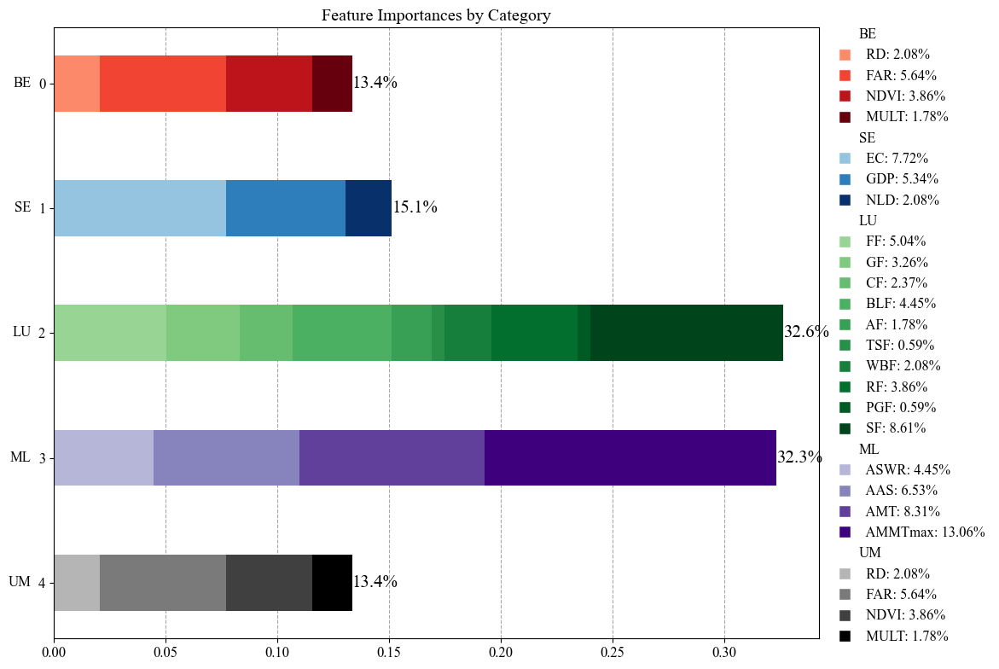

In [35]:
import matplotlib.pyplot as plt
import numpy as np

# 直接提供特征及其对应的SHAP值
feature_shap_values = [
     ('AMMTmax', 0.44), ('SF', 0.29),('AMT', 0.28),('EC', 0.26),('AAS', 0.22),('BCM', 0.22),
    ('FAR', 0.19),('GDP', 0.18),('FF', 0.17),('ASWR', 0.15),('BLF', 0.15),('NDVI', 0.13),
    ('RF', 0.13),('GF', 0.11),('CF', 0.08),('WBF', 0.07),('NLD', 0.07),('RD', 0.07),
    ('AF', 0.06),('MULT', 0.06),('TSF', 0.02),('PGF', 0.02)
]

# 计算SHAP值总和
total_shap_value = sum(value for _, value in feature_shap_values)

# 分类字典
category_dict = {
    'BE': ['RD', 'FAR', 'NDVI', 'MULT'],
    'SE': ['EC', 'GDP', 'NLD'],
    'LU': ['FF', 'GF', 'CF', 'BLF', 'AF', 'TSF', 'WBF', 'RF', 'PGF', 'SF'],
    'ML': ['ASWR', 'AAS', 'AMT', 'AMMTmax'],
    'UM': ['RD', 'FAR', 'NDVI', 'MULT']
}

# 根据类别给特征分组并生成对应的颜色
category_colors = {
    'BE': plt.cm.Reds(np.linspace(0.4, 1, len(category_dict['BE']))),
    'SE': plt.cm.Blues(np.linspace(0.4, 1, len(category_dict['SE']))),
    'LU': plt.cm.Greens(np.linspace(0.4, 1, len(category_dict['LU']))),
    'ML': plt.cm.Purples(np.linspace(0.4, 1, len(category_dict['ML']))),
    'UM': plt.cm.Greys(np.linspace(0.4, 1, len(category_dict['UM'])))
}

fig, ax = plt.subplots(figsize=(10, 8))

y_positions = np.arange(len(category_dict))  # 每个大类别的位置
bar_height = 0.45  # 条形图的高度

for idx, (cat, features) in enumerate(category_dict.items()):
    sizes = [next(val for name, val in feature_shap_values if name == feature) / total_shap_value for feature in features]
    colors = category_colors[cat][:len(features)]
    
    left = 0
    for i, size in enumerate(sizes):
        ax.barh(y_positions[idx], size, height=bar_height, left=left, color=colors[i])
        left += size
    
    # 计算并显示每个大类别的百分比
    cat_total = sum(sizes)
    ax.text(left + 0.00, y_positions[idx], f'{cat_total*100:.1f}%', va='center', ha='left', color='black', fontsize=15)
    
    # 添加类别名称
    ax.text(-0.01, y_positions[idx], cat, va='center', ha='right')

ax.invert_yaxis()  # 反转y轴，使BE在最上方

plt.title('Feature Importances by Category')
plt.tight_layout()

# 增加网格线
ax.grid(True, axis='x', linestyle='--', which='major', color='gray', alpha=0.7)
ax.set_axisbelow(True)  # 网格线置于条形图之下

# 添加图例
legend_elements = []
for cat, features in category_dict.items():
    legend_elements.append(plt.Line2D([0], [0], marker='s', color='w', label=f'{cat}', markersize=6))
    for i, feature in enumerate(features):
        color_index = min(i, len(category_colors[cat])-1)
        legend_elements.append(plt.Line2D([0], [0], marker='s', color='w', label=f'  {feature}: {(next(val for name, val in feature_shap_values if name == feature) / total_shap_value)*100:.2f}%', markerfacecolor=category_colors[cat][color_index], markersize=10))

# 将图例移动到条形图的右侧
plt.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(1.12, 1.02), frameon=False, handletextpad=0.5, handlelength=1)

plt.show()

In [36]:
shap_interaction_values = shap.TreeExplainer(model).shap_interaction_values(data[cols])

[20:12:25] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0750514818a16474a-1\xgboost\xgboost-ci-windows\src\c_api\c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.


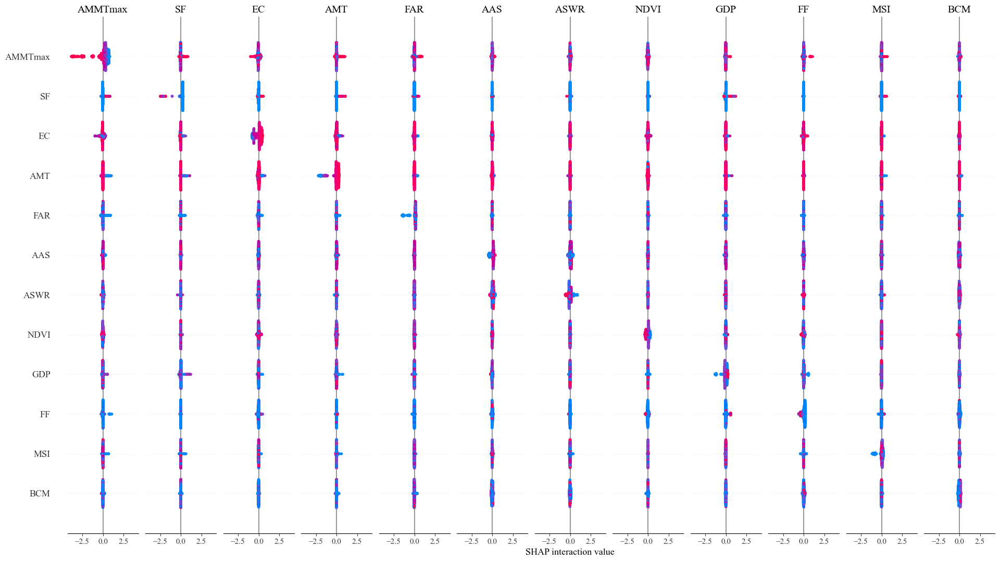

In [37]:
shap.summary_plot(shap_interaction_values, data[cols], max_display=12)

In [42]:
plt.rcParams['font.size'] = 14
plt.rcParams['figure.dpi'] = 1000
plt.rcParams['font.family'] = 'Times New Roman'

In [47]:
#正确修改了横坐标标签科学计数法
import os
import shap
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter

# 定义要分析的变量组合
variable_pairs = [
    ('FAR', 'NDVI'), ('FAR', 'EC'), ('FAR', 'GDP'), ('FAR', 'SF'), ('FAR', 'FF'),
    ('FAR', 'ASWR'), ('FAR', 'AAS'), ('FAR', 'PD'), ('FAR', 'DGF'),
    ('NDVI', 'EC'), ('NDVI', 'GDP'), ('NDVI', 'SF'), ('NDVI', 'FF'),
    ('NDVI', 'ASWR'), ('NDVI', 'AAS'), ('NDVI', 'PD'), ('NDVI', 'DGF'),
    ('EC', 'GDP'), ('EC', 'SF'), ('EC', 'FF'), ('EC', 'ASWR'), ('EC', 'AAS'),
    ('EC', 'PD'), ('EC', 'DGF'), ('GDP', 'SF'), ('GDP', 'FF'), ('GDP', 'ASWR'),
    ('GDP', 'AAS'), ('GDP', 'PD'), ('GDP', 'DGF'), ('SF', 'FF'), ('SF', 'ASWR'),
    ('SF', 'AAS'), ('SF', 'PD'), ('SF', 'DGF'), ('FF', 'ASWR'), ('FF', 'AAS'),
    ('FF', 'PD'), ('FF', 'DGF'), ('ASWR', 'AMT'), ('ASWR', 'PD'),
    ('ASWR', 'DGF'), ('AAS', 'PD'), ('AAS', 'DGF'), ('PD', 'DGF')
]

# 创建文件夹用于保存图像
output_folder = r'F:\第三篇论文写作\代码出图\PDP合并\新交互作用\交互作用-1'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# 循环遍历每个变量组合并生成依赖图
for var1, var2 in variable_pairs:
    # 如果第二个变量是None，则只绘制单个变量的影响
    if var2 is None:
        shap.dependence_plot(var1, shap_values, data[cols], show=False, cmap="viridis")
    else:
        shap.dependence_plot(var1, shap_values, data[cols], interaction_index=var2, show=False, cmap="viridis")

    # 获取当前图形和轴
    fig = plt.gcf()
    ax = plt.gca()

    # 设置xy轴标签字体和大小
    ax.set_xlabel(ax.get_xlabel(), fontsize=24, fontname='Times New Roman')
    ax.set_ylabel(ax.get_ylabel(), fontsize=24, fontname='Times New Roman')

    # 设置刻度标签字体和大小
    for tick in ax.get_xticklabels() + ax.get_yticklabels():
        tick.set_fontsize(24)
        tick.set_fontname('Times New Roman')

    # === 强制启用科学计数法（关键修改部分）===
    ax.ticklabel_format(style='sci', axis='both', scilimits=(-3, 3), useOffset=False)

    # 可选：如果你还想进一步控制字体大小和样式
    ax.xaxis.offsetText.set_fontsize(20)
    ax.yaxis.offsetText.set_fontsize(20)
    ax.xaxis.offsetText.set_fontname('Times New Roman')
    ax.yaxis.offsetText.set_fontname('Times New Roman')

    # 保存图像
    plt.savefig(os.path.join(output_folder, f'{var1}_{var2}.png'), bbox_inches='tight', dpi=1200)
    plt.close()  # 关闭当前图像以释放内存

print("所有图像已保存完毕。")

所有图像已保存完毕。


In [48]:
import os
import shap
import matplotlib.pyplot as plt

# 假设shap_values, data 和 cols 已经定义
# shap_values = ...
# data = ...
# cols = ...

# 定义要分析的变量组合
variable_pairs = [
    ('FAR', 'NDVI'), ('FAR', 'EC'), ('FAR', 'GDP'), ('FAR', 'SF'), ('FAR', 'FF'),
    ('FAR', 'AMMTmax'), ('FAR', 'AMT'), ('FAR', 'RD'), ('FAR', 'MULT'),
    ('NDVI', 'EC'), ('NDVI', 'GDP'), ('NDVI', 'SF'), ('NDVI', 'FF'),
    ('NDVI', 'AMMTmax'), ('NDVI', 'AMT'), ('NDVI', 'RD'), ('NDVI', 'MULT'),
    ('EC', 'GDP'), ('EC', 'SF'), ('EC', 'FF'), ('EC', 'AMMTmax'), ('EC', 'AMT'),
    ('EC', 'RD'), ('EC', 'MULT'), ('GDP', 'SF'), ('GDP', 'FF'), ('GDP', 'AMMTmax'),
    ('GDP', 'AMT'), ('GDP', 'RD'), ('GDP', 'MULT'), ('SF', 'FF'), ('SF', 'AMMTmax'),
    ('SF', 'AMT'), ('SF', 'RD'), ('SF', 'MULT'), ('FF', 'AMMTmax'), ('FF', 'AMT'),
    ('FF', 'RD'), ('FF', 'MULT'), ('AMMTmax', 'AMT'), ('AMMTmax', 'RD'),
    ('AMMTmax', 'MULT'), ('AMT', 'RD'), ('AMT', 'MULT'), ('RD', 'MULT')
]

# 创建文件夹用于保存图像
output_folder = r'F:\第三篇论文写作\代码出图\PDP合并\交互作用-1'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# 循环遍历每个变量组合并生成依赖图
for var1, var2 in variable_pairs:
    if var2 is None:  # 单变量情况
        shap.dependence_plot(var1, shap_values, data[cols], show=False, cmap="viridis")
    else:  # 双变量情况
        shap.dependence_plot(var1, shap_values, data[cols], interaction_index=var2, cmap="viridis", show=False)
    
    fig, ax = plt.gcf(), plt.gca()
    
    # 设置xy轴标签字体和大小
    ax.set_xlabel(ax.get_xlabel(), fontsize=24, fontname='Times New Roman')
    ax.set_ylabel(ax.get_ylabel(), fontsize=24, fontname='Times New Roman')
    
    # 设置刻度标签字体和大小
    for tick in ax.get_xticklabels() + ax.get_yticklabels():
        tick.set_fontsize(24)
        tick.set_fontname('Times New Roman')
    
    # 对于包含特定变量（EC, GDP, NDVI）的情况，保持科学计数形式
    if 'EC' in [var1, var2] or 'GDP' in [var1, var2] or 'NDVI' in [var1, var2]or 'SF' in [var1, var2]:
        ax.ticklabel_format(style='sci', scilimits=(-3,4), axis='both')
    
    # 保存图像
    plt.savefig(os.path.join(output_folder, f'{var1}_{var2}.png'), bbox_inches='tight', dpi=1200)
    plt.close()  # 关闭当前图像以释放内存

print("所有图像已保存完毕。")

所有图像已保存完毕。


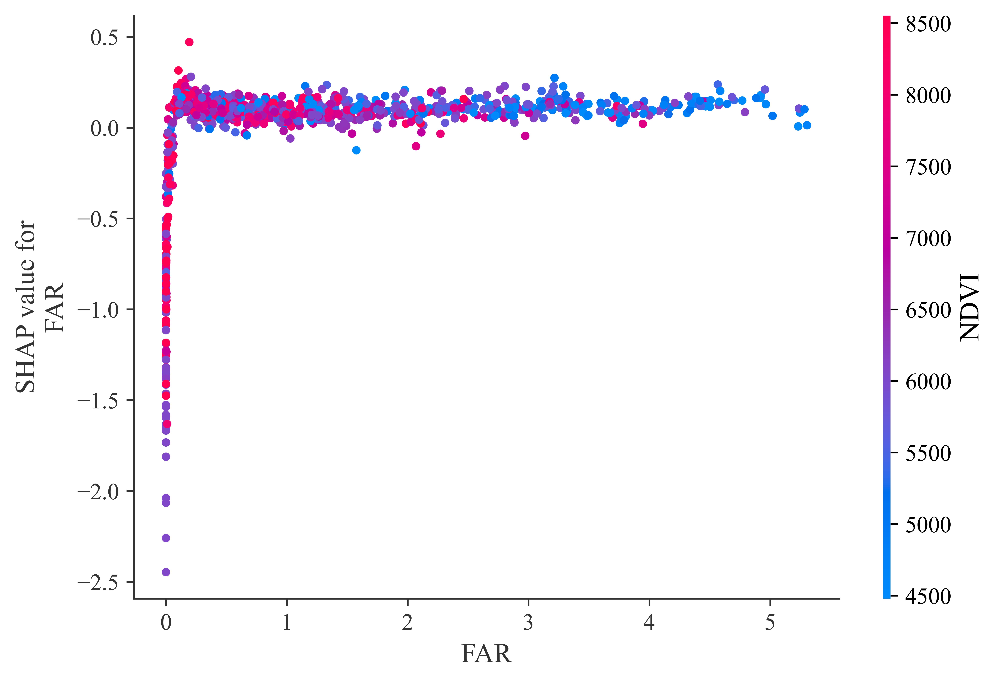

In [43]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('FAR', shap_values, data[cols], interaction_index='NDVI', show=False)

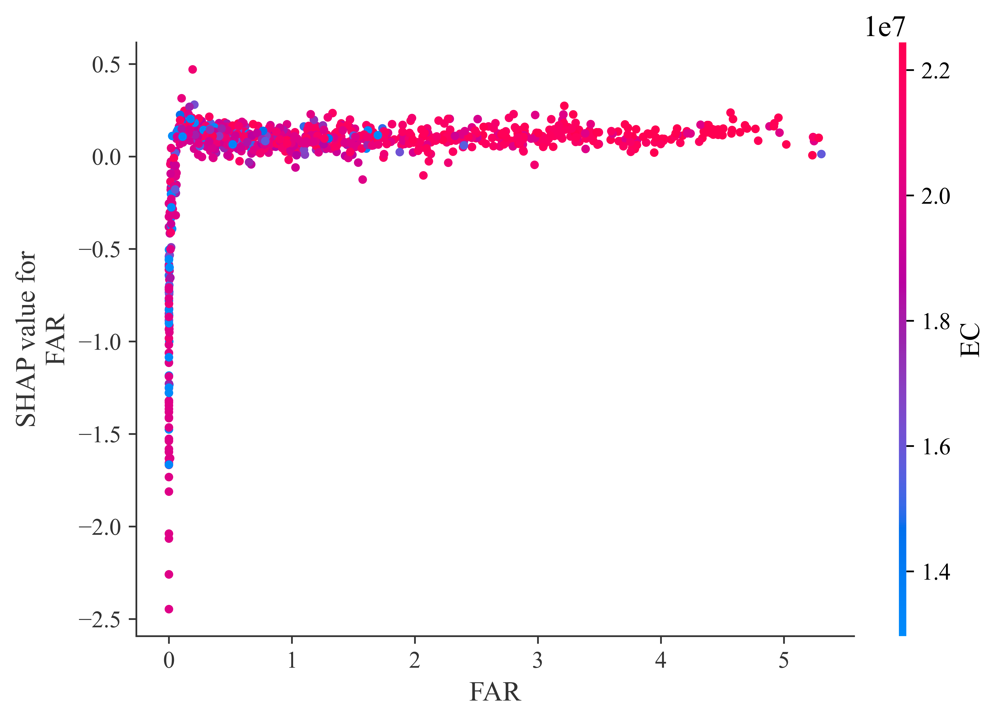

In [44]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('FAR', shap_values, data[cols], interaction_index='EC', show=False)

In [45]:
import os
import shap
import matplotlib.pyplot as plt



# 定义要分析的变量组合
variable_pairs = [
    ('FAR', 'NDVI'), ('FAR', 'EC'), ('FAR', 'GDP'), ('FAR', 'SF'), ('FAR', 'FF'),
    ('FAR', 'AMMTmax'), ('FAR', 'AMT'), ('FAR', 'RD'), ('FAR', 'MULT'),
    ('NDVI', 'EC'), ('NDVI', 'GDP'), ('NDVI', 'SF'), ('NDVI', 'FF'),
    ('NDVI', 'AMMTmax'), ('NDVI', 'AMT'), ('NDVI', 'RD'), ('NDVI', 'MULT'),
    ('EC', 'GDP'), ('EC', 'SF'), ('EC', 'FF'), ('EC', 'AMMTmax'), ('EC', 'AMT'),
    ('EC', 'RD'), ('EC', 'MULT'), ('GDP', 'SF'), ('GDP', 'FF'), ('GDP', 'AMMTmax'),
    ('GDP', 'AMT'), ('GDP', 'RD'), ('GDP', 'MULT'), ('SF', 'FF'), ('SF', 'AMMTmax'),
    ('SF', 'AMT'), ('SF', 'RD'), ('SF', 'MULT'), ('FF', 'AMMTmax'), ('FF', 'AMT'),
    ('FF', 'RD'), ('FF', 'MULT'), ('AMMTmax', 'AMT'), ('AMMTmax', 'RD'),
    ('AMMTmax', 'MULT'), ('AMT', 'RD'), ('AMT', 'MULT'), ('RD', 'MULT')
]

# 创建文件夹用于保存图像
output_folder = r'F:\第三篇论文写作\代码出图\PDP合并\交互作用-1'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# 循环遍历每个变量组合并生成依赖图
for var1, var2 in variable_pairs:
    # 如果第二个变量是None，则只绘制单个变量的影响
    if var2 is None:
        shap.dependence_plot(var1, shap_values, data[cols], show=False)
    else:
        shap.dependence_plot(var1, shap_values, data[cols], interaction_index=var2, show=False)
    
    # 保存图像
    plt.savefig(os.path.join(output_folder, f'{var1}_{var2}.png'), bbox_inches='tight', dpi=300)
    plt.close()  # 关闭当前图像以释放内存

print("所有图像已保存完毕。")

所有图像已保存完毕。


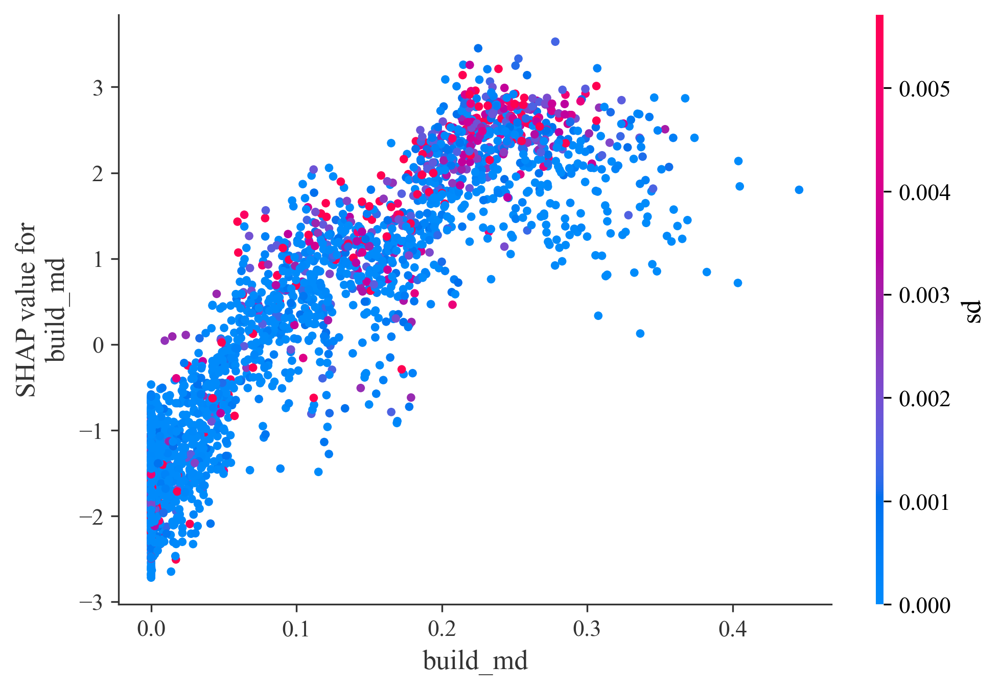

In [47]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('build_md', shap_values, data[cols], interaction_index='sd', show=False)

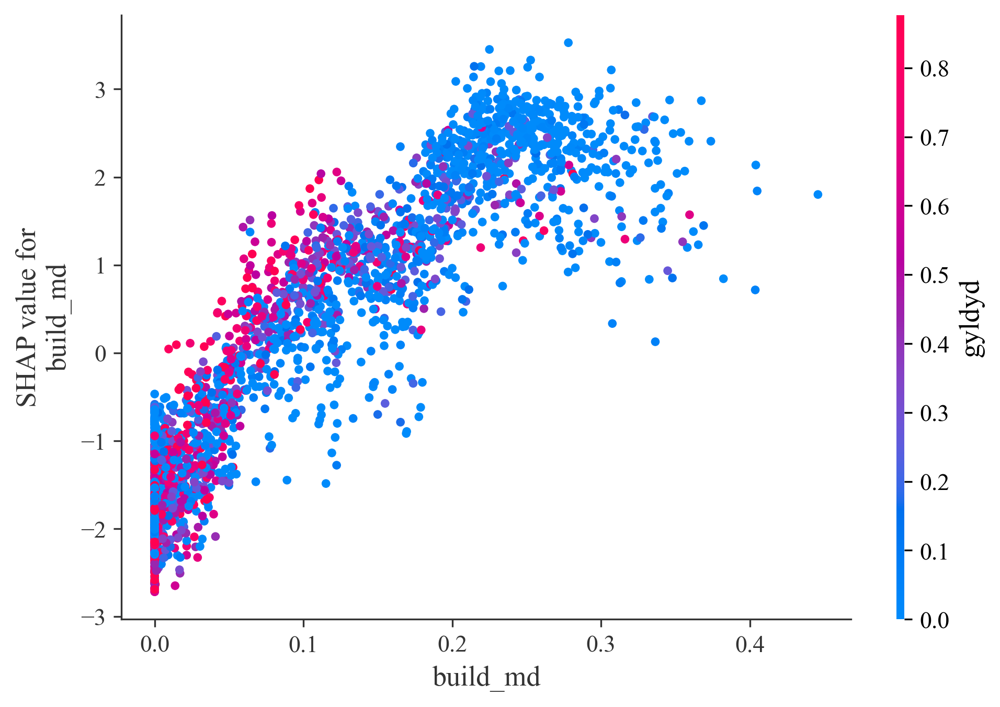

In [48]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('build_md', shap_values, data[cols], interaction_index='gyldyd', show=False)

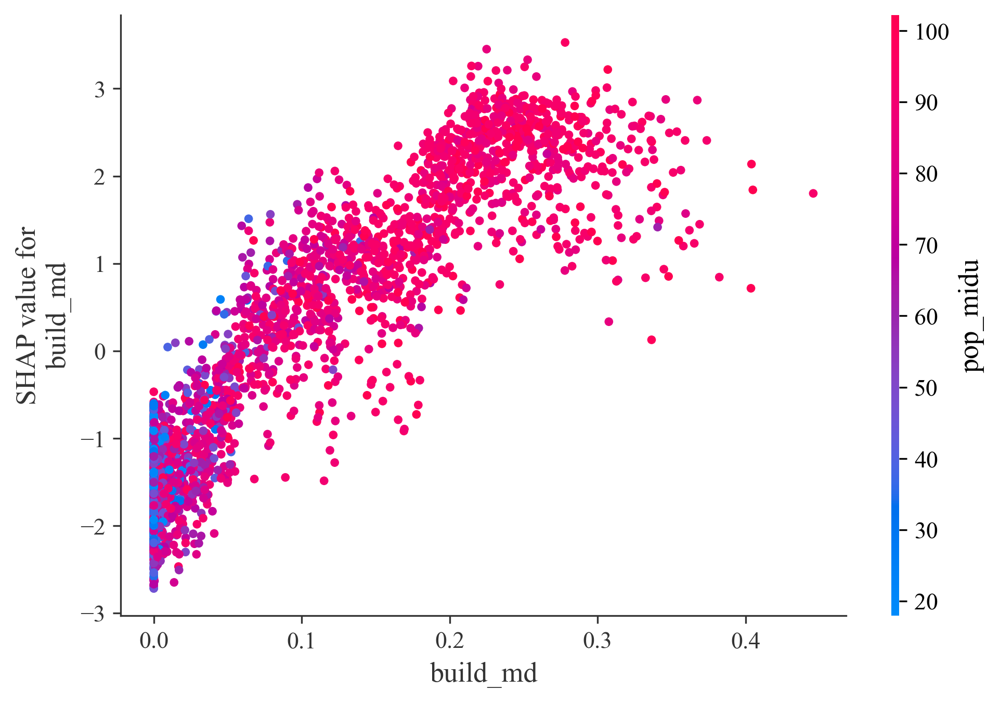

In [49]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('build_md', shap_values, data[cols], interaction_index='pop_midu', show=False)

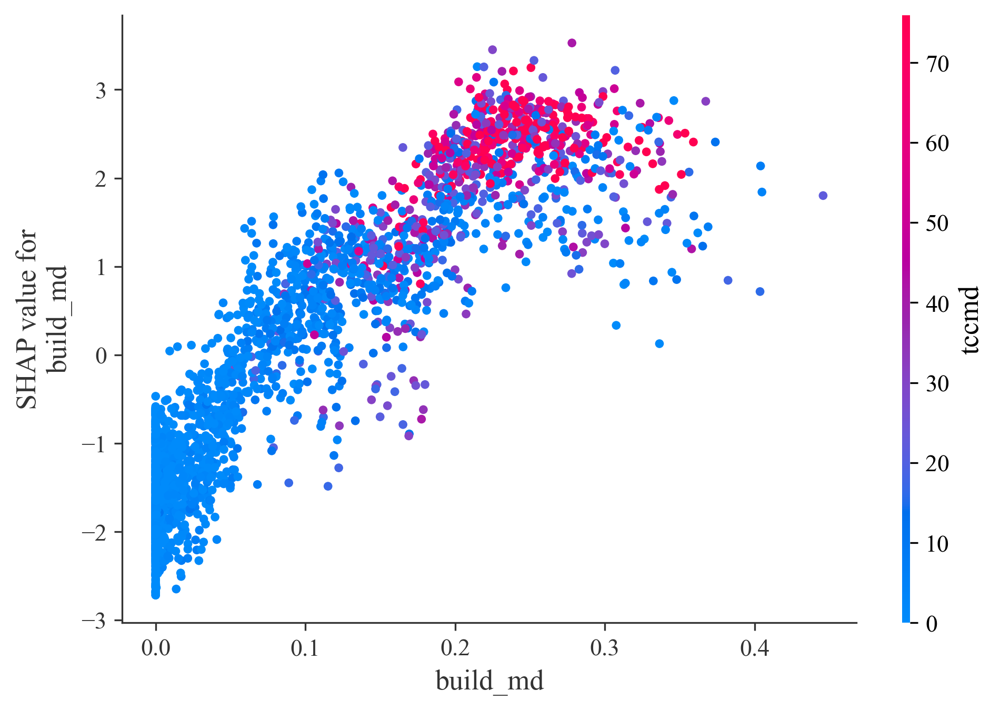

In [50]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('build_md', shap_values, data[cols], interaction_index='tccmd', show=False)

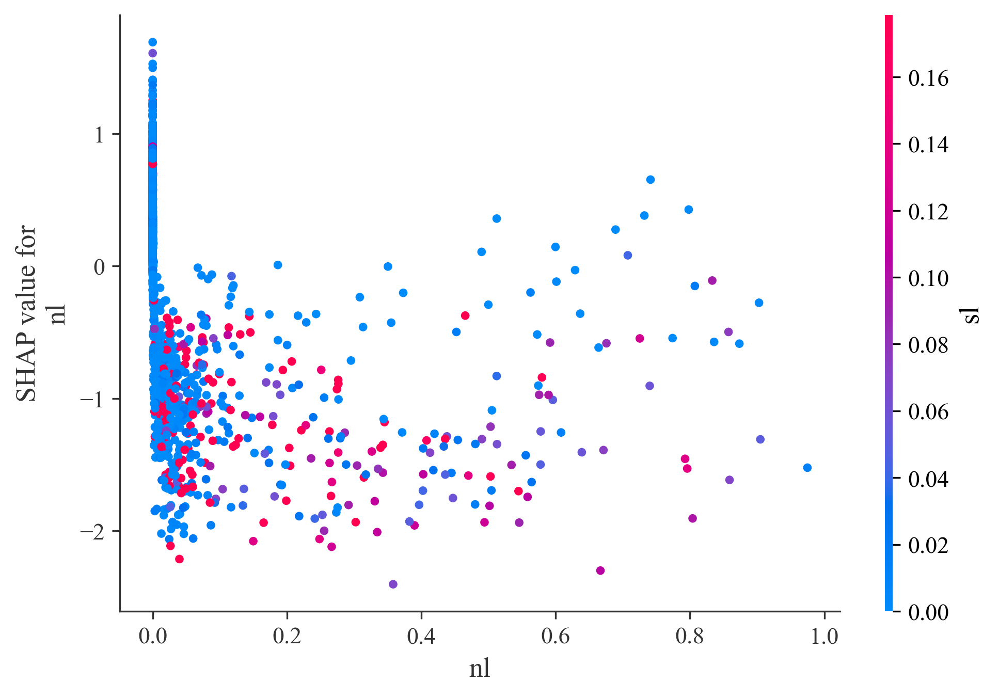

In [51]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('nl', shap_values, data[cols], interaction_index='sl', show=False)

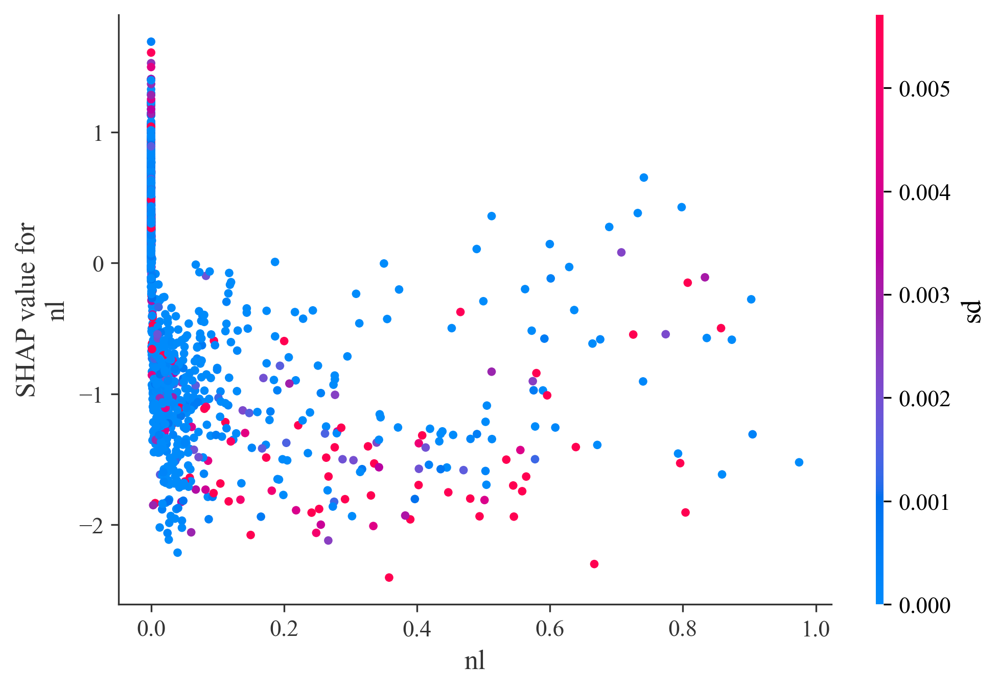

In [52]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('nl', shap_values, data[cols], interaction_index='sd', show=False)

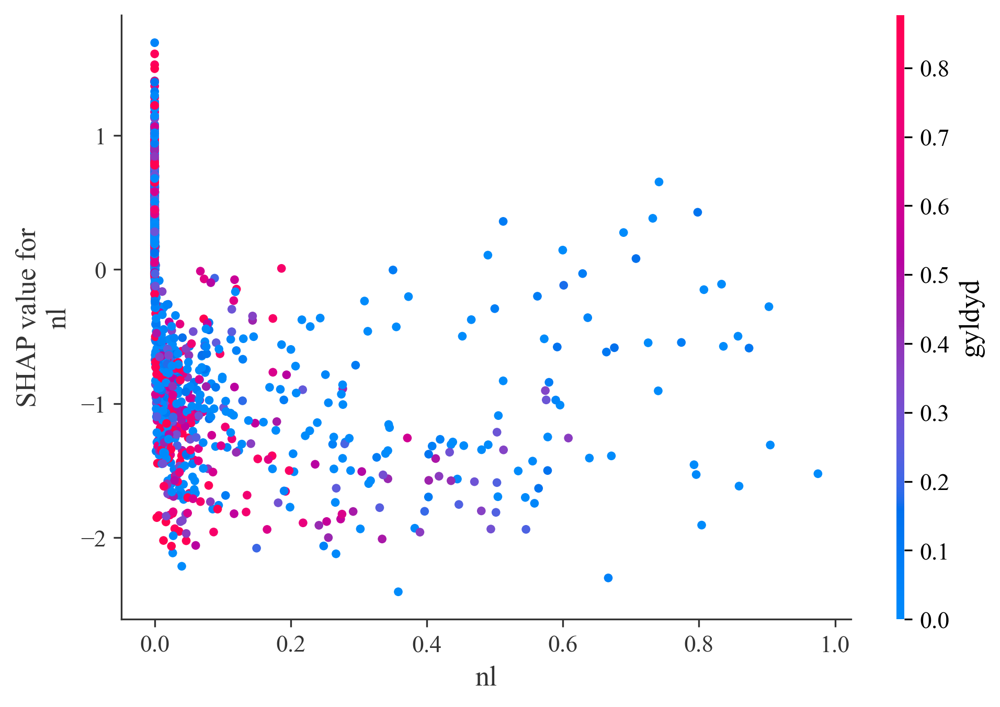

In [53]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('nl', shap_values, data[cols], interaction_index='gyldyd', show=False)

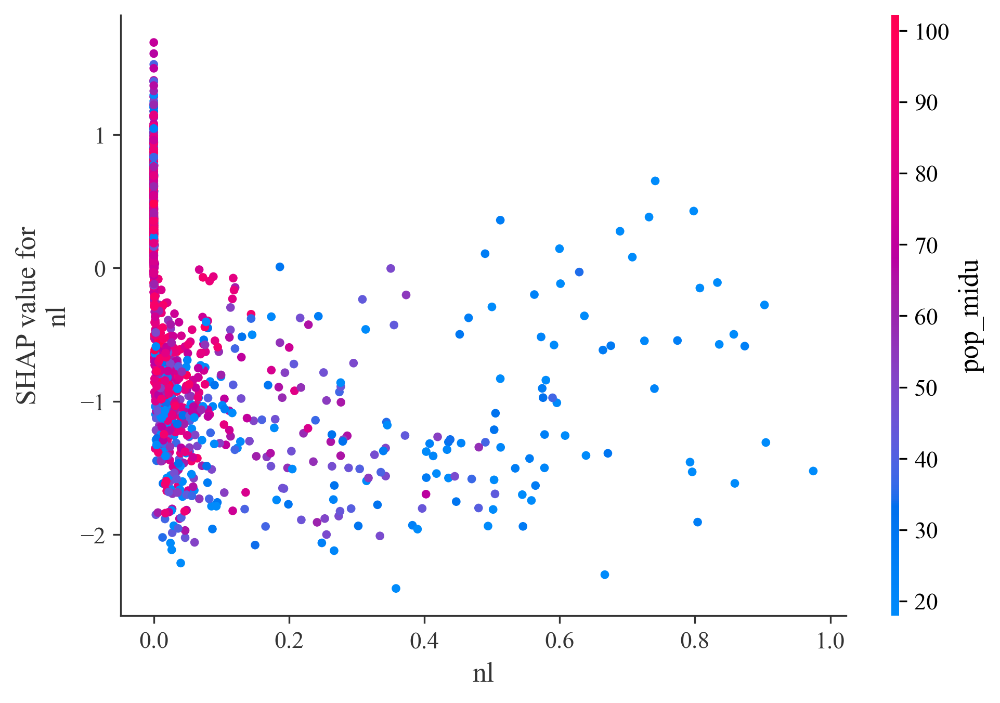

In [54]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('nl', shap_values, data[cols], interaction_index='pop_midu', show=False)

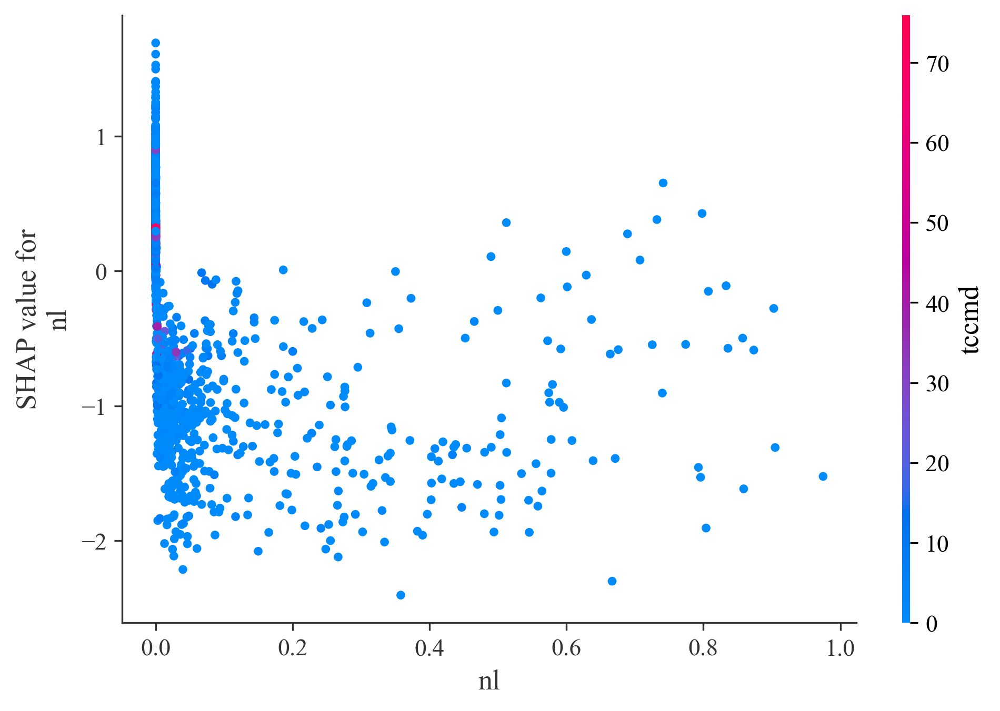

In [55]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('nl', shap_values, data[cols], interaction_index='tccmd', show=False)

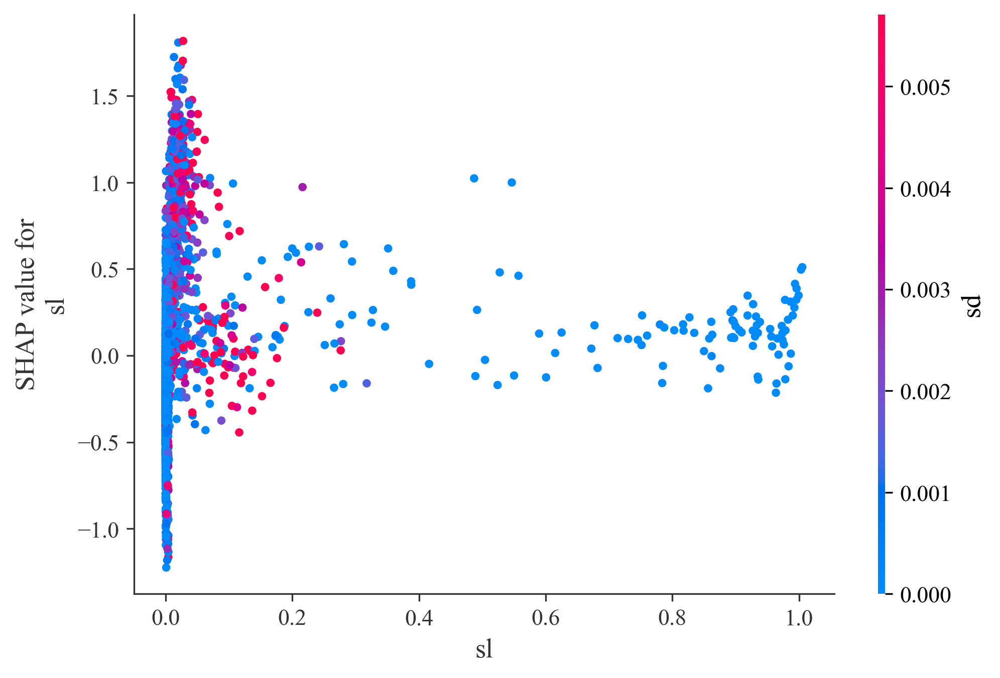

In [56]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sl', shap_values, data[cols], interaction_index='sd', show=False)

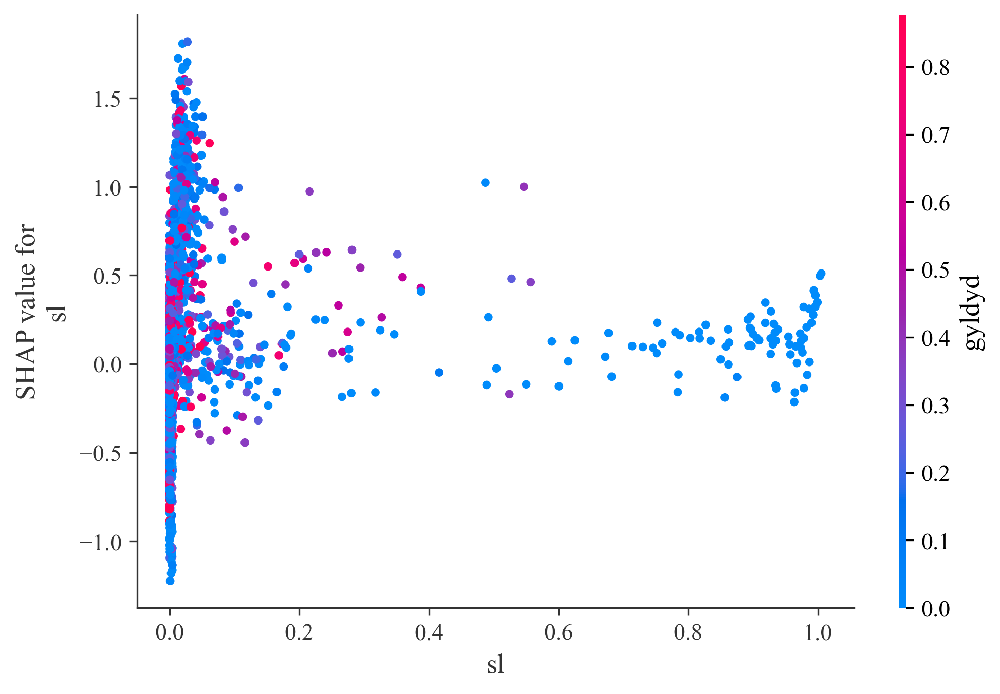

In [57]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sl', shap_values, data[cols], interaction_index='gyldyd', show=False)

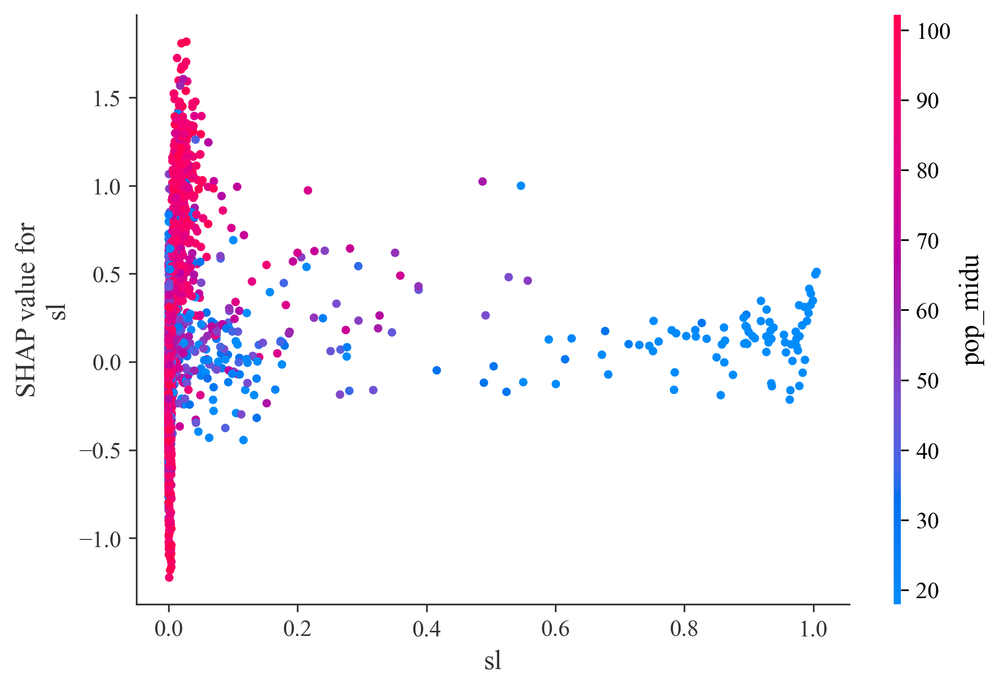

In [58]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sl', shap_values, data[cols], interaction_index='pop_midu', show=False)

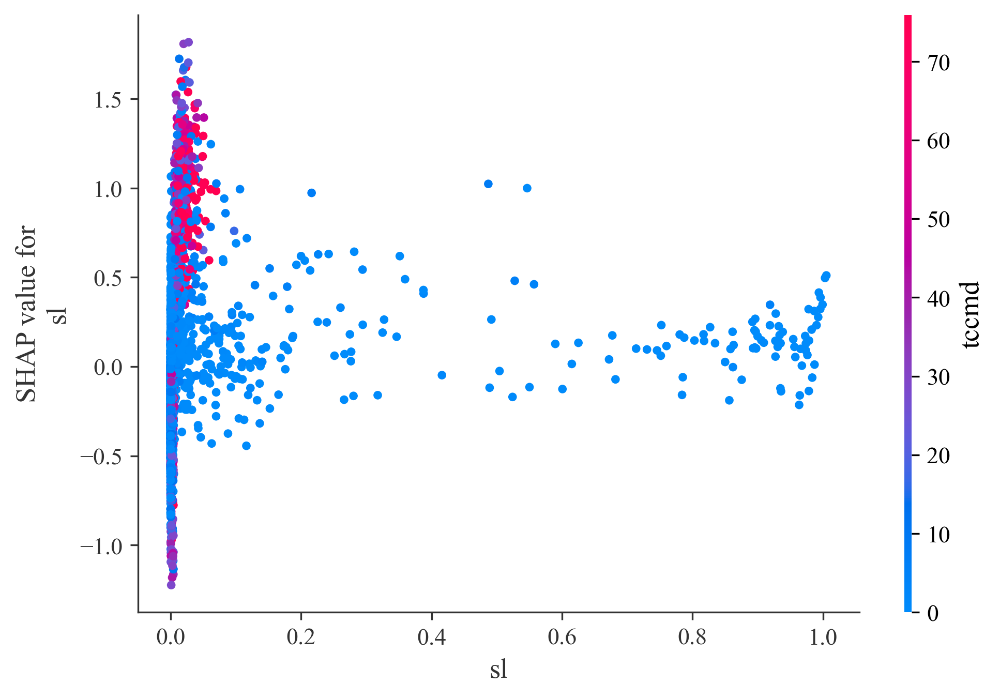

In [59]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sl', shap_values, data[cols], interaction_index='tccmd', show=False)

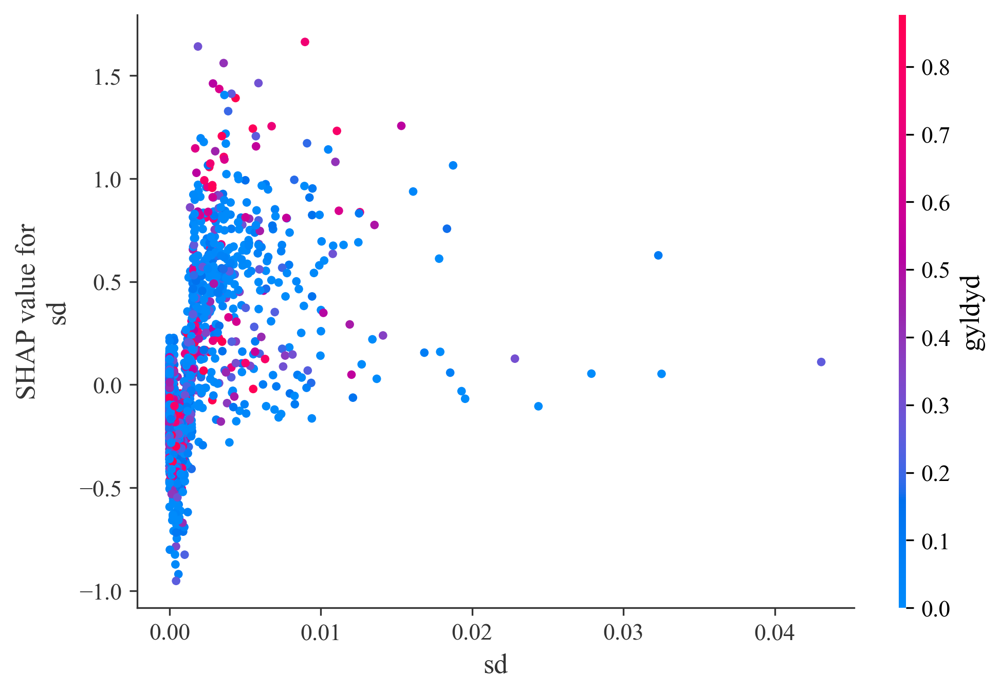

In [60]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sd', shap_values, data[cols], interaction_index='gyldyd', show=False)

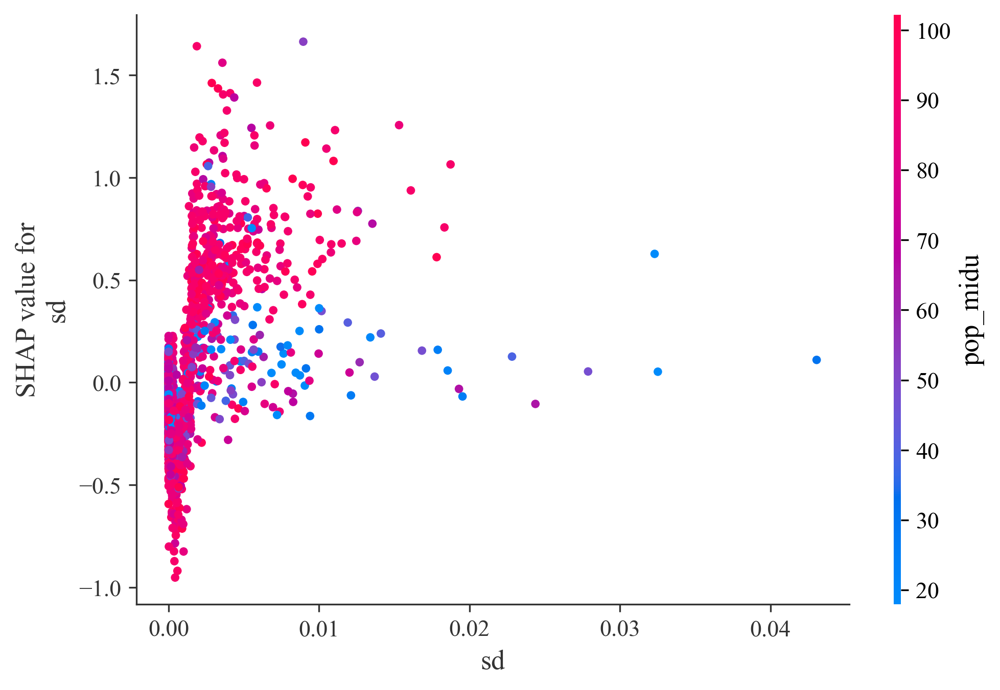

In [61]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sd', shap_values, data[cols], interaction_index='pop_midu', show=False)

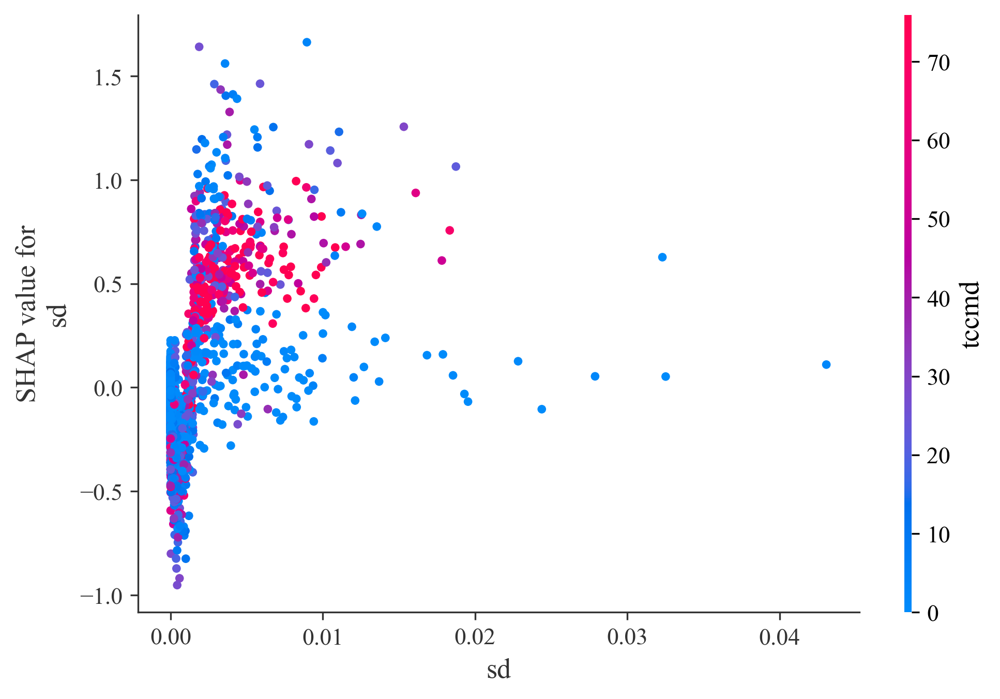

In [62]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('sd', shap_values, data[cols], interaction_index='tccmd', show=False)

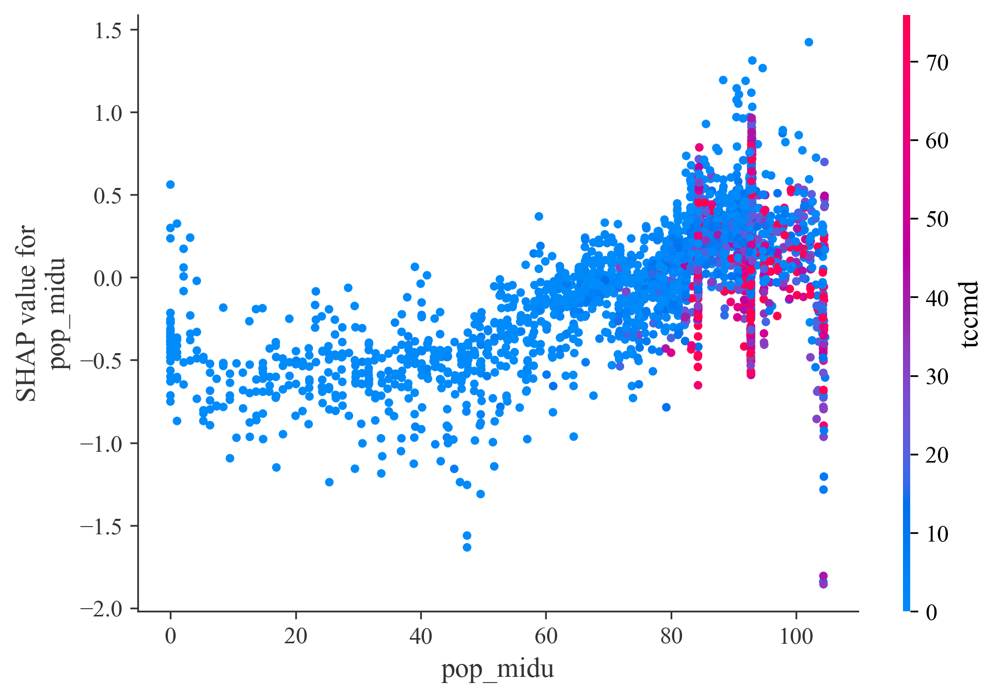

In [63]:
# 描绘两个变量交互下变量对目标值的影响，选择用哪两个变量交互
shap.dependence_plot('pop_midu', shap_values, data[cols], interaction_index='tccmd', show=False)

# PDP

In [38]:
from pdpbox import pdp
def plot_pdp(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # plot it
    pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag,figsize=(20,16))

You selected FAR


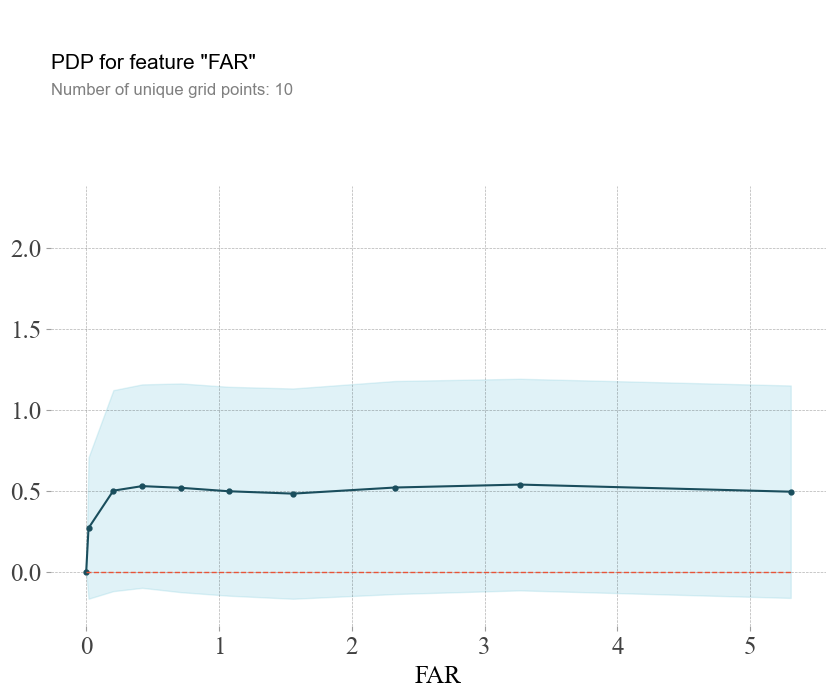

Extracting coordinates of the lines...
Middle Line Coordinates: [(0.0, 0.0), (0.017474181, 0.26988602), (0.204361446, 0.5008774), (0.4210595349999998, 0.52890015), (0.714374695, 0.5184288), (1.072437753, 0.497303), (1.5571170579999996, 0.48260117), (2.325432725999998, 0.5203209), (3.265460718, 0.53847885), (5.304727111, 0.49446106)]
Upper Bound Coordinates: [(0.0, 0.0), (0.0, 0.0), (0.017474181, 0.7060435712337494), (0.204361446, 1.12122642993927), (0.4210595349999998, 1.1568576097488403), (0.714374695, 1.1627709865570068), (1.072437753, 1.1420883536338806), (1.5571170579999996, 1.131650447845459), (2.325432725999998, 1.1778391003608704), (3.265460718, 1.1916971802711487), (5.304727111, 1.1502256989479065), (5.304727111, -0.1613035798072815), (5.304727111, -0.1613035798072815), (3.265460718, -0.11473947763442993), (2.325432725999998, -0.1371973156929016), (1.5571170579999996, -0.16644811630249023), (1.072437753, -0.14748233556747437), (0.714374695, -0.12591338157653809), (0.42105953499

In [46]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\FAR1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'FAR'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected NDVI


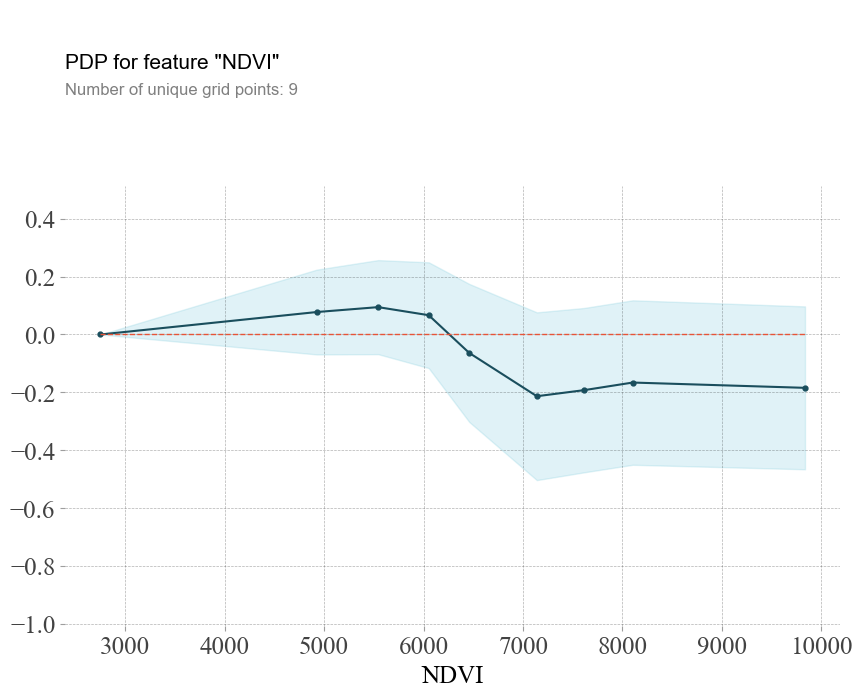

Extracting coordinates of the lines...
Middle Line Coordinates: [(2748.0, 0.0), (4925.0, 0.077560425), (5543.0, 0.09446716), (6051.811182, 0.06665039), (6460.0, -0.06374359), (7139.999999999996, -0.21318817), (7616.0, -0.19221497), (8105.0, -0.16593552), (9839.0, -0.18421173)]
Upper Bound Coordinates: [(2748.0, 0.0), (2748.0, 0.0), (4925.0, 0.22400391101837158), (5543.0, 0.2568753510713577), (6051.811182, 0.2492593228816986), (6460.0, 0.1746271401643753), (7139.999999999996, 0.07647654414176941), (7616.0, 0.09158611297607422), (8105.0, 0.11805799603462219), (9839.0, 0.09706568717956543), (9839.0, -0.46548914909362793), (9839.0, -0.46548914909362793), (8105.0, -0.44992902874946594), (7616.0, -0.4760160446166992), (7139.999999999996, -0.5028528869152069), (6460.0, -0.3021143227815628), (6051.811182, -0.11595854163169861), (5543.0, -0.06794102489948273), (4925.0, -0.06888306140899658), (2748.0, 0.0), (2748.0, 0.0)]
Calculated Lower Bound Coordinates (x same as Middle Line): [(2748.0, 0.0)

In [50]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\NDVI1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'NDVI'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected build_md


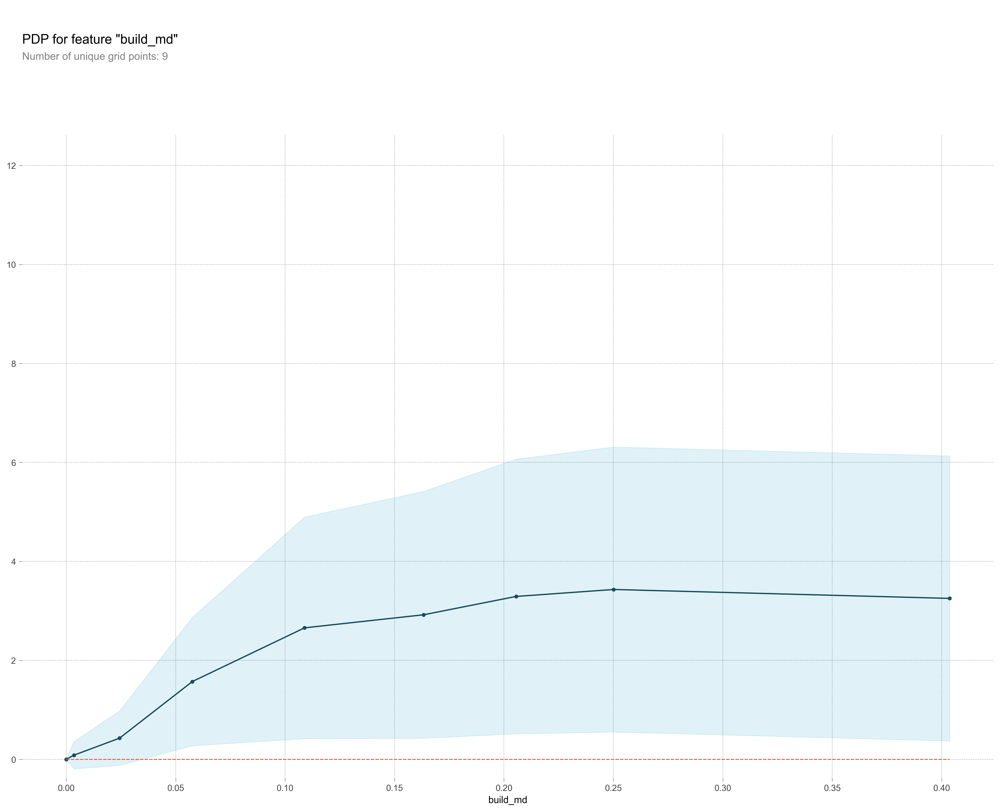

In [38]:
#@title Select a predictor to analyse Linear Regression Model. { run: "auto" }

selected_predictor = "build_md" #@param ['Age_08_04', 'KM', 'HP', 'Met_Color', 'Automatic', 'cc', 'Doors', 'Weight']
print('You selected', selected_predictor)
plot_pdp(model, X_train, selected_predictor)

In [39]:
from pdpbox import pdp
def plot_pdp(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # plot it
    pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(20,16))

You selected nl


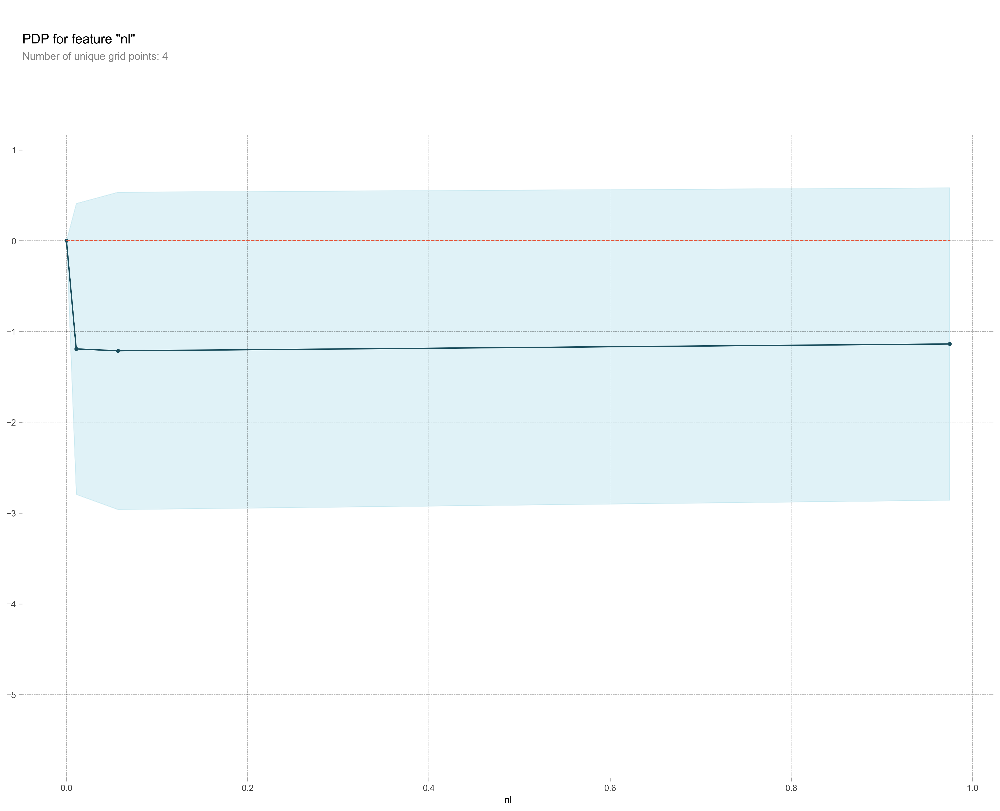

In [40]:
selected_predictor = 'nl'
print('You selected', selected_predictor)
plot_pdp(model, X, selected_predictor)

You selected sl


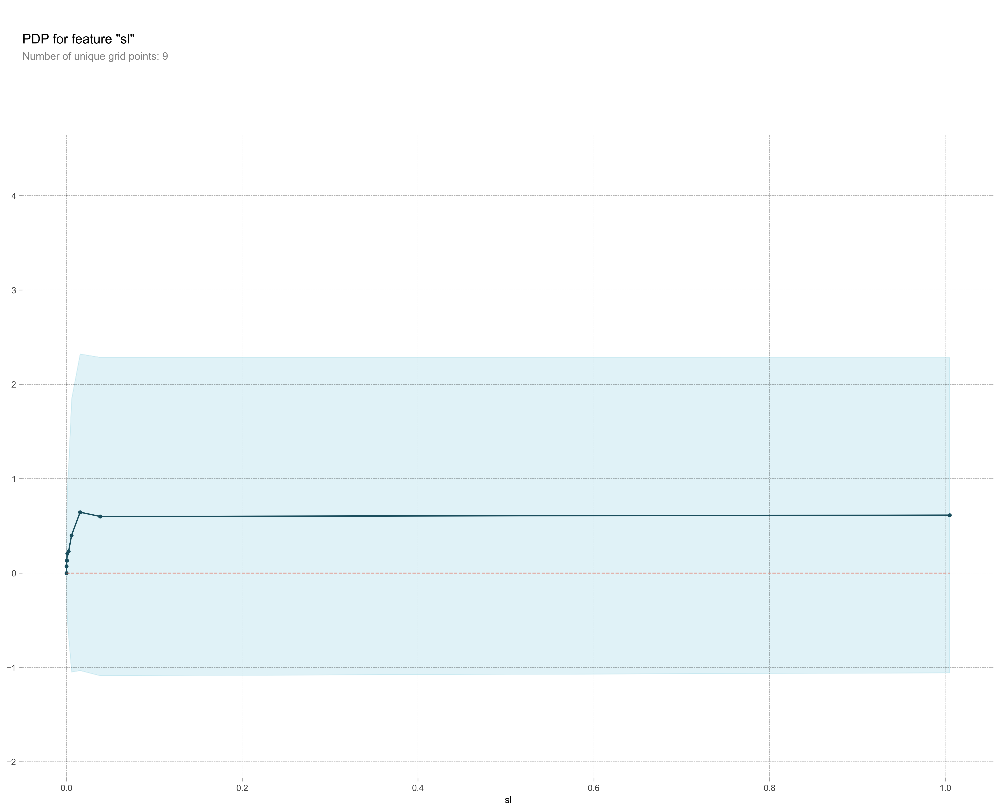

In [41]:
selected_predictor = "sl" 
print('You selected', selected_predictor)
plot_pdp(model, X, selected_predictor)

You selected sd


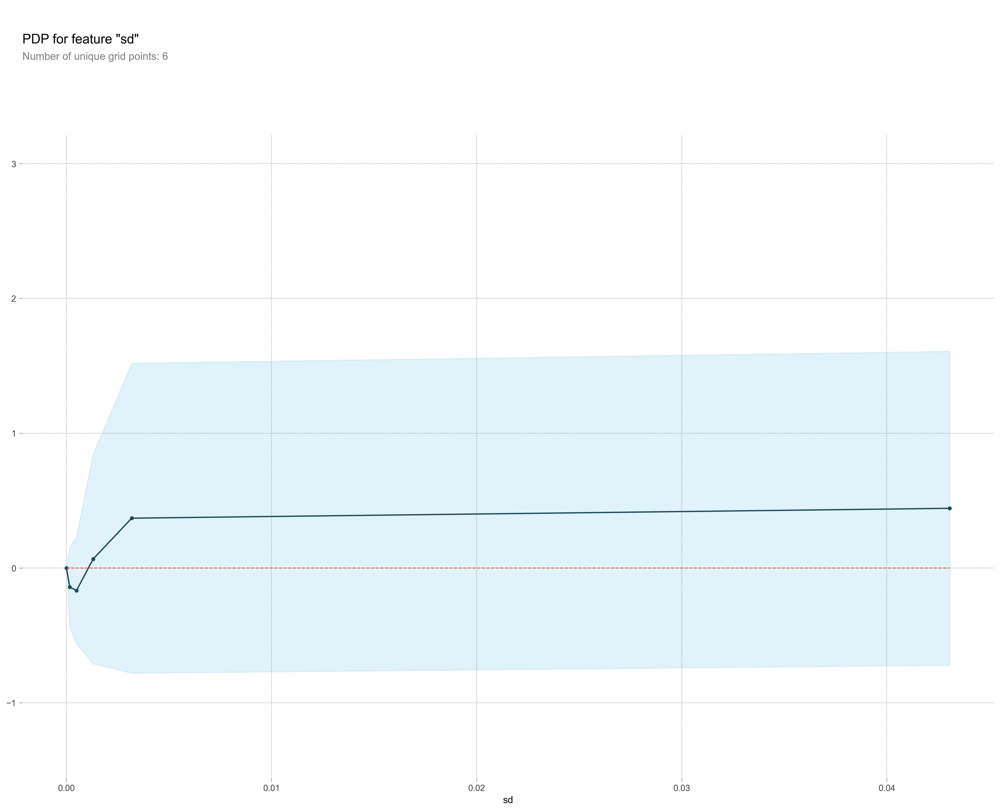

In [42]:
selected_predictor = "sd" 
print('You selected', selected_predictor)
plot_pdp(model, X, selected_predictor)

You selected gyldyd


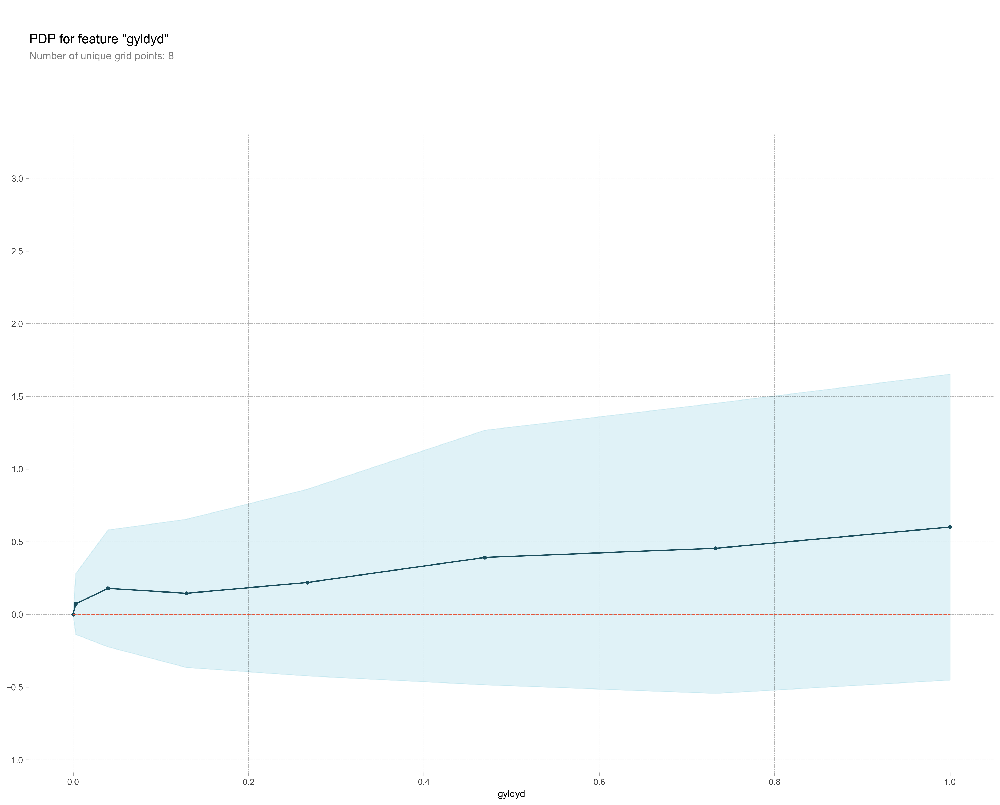

In [43]:
selected_predictor = "gyldyd" 
print('You selected', selected_predictor)
plot_pdp(model, X, selected_predictor)

You selected pop_midu


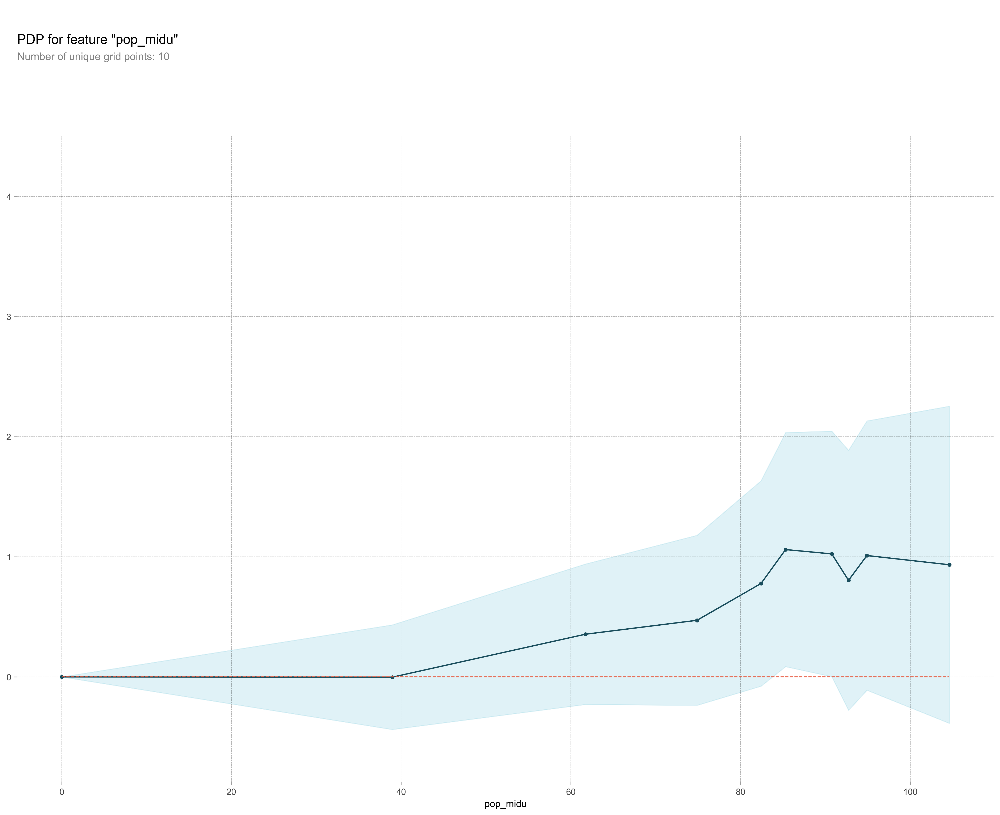

In [44]:
selected_predictor = "pop_midu" 
print('You selected', selected_predictor)
plot_pdp(model, X, selected_predictor)

You selected tccmd


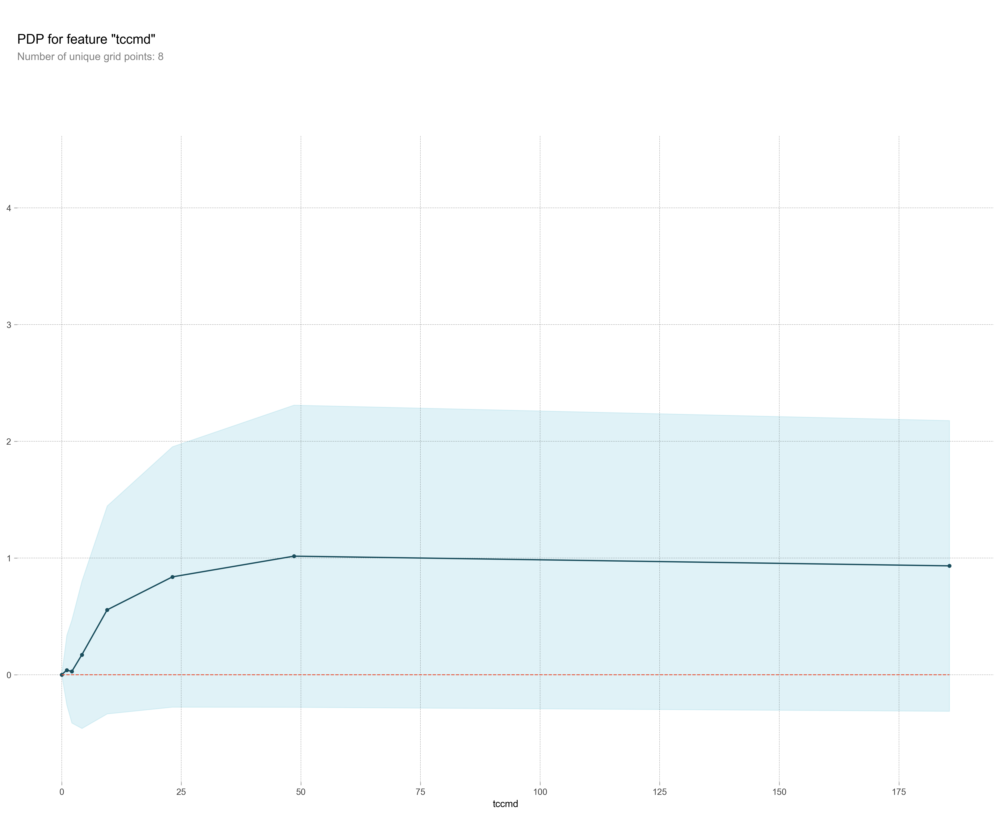

In [45]:
selected_predictor = "tccmd" 
print('You selected', selected_predictor)
plot_pdp(model, X, selected_predictor)

You selected EC


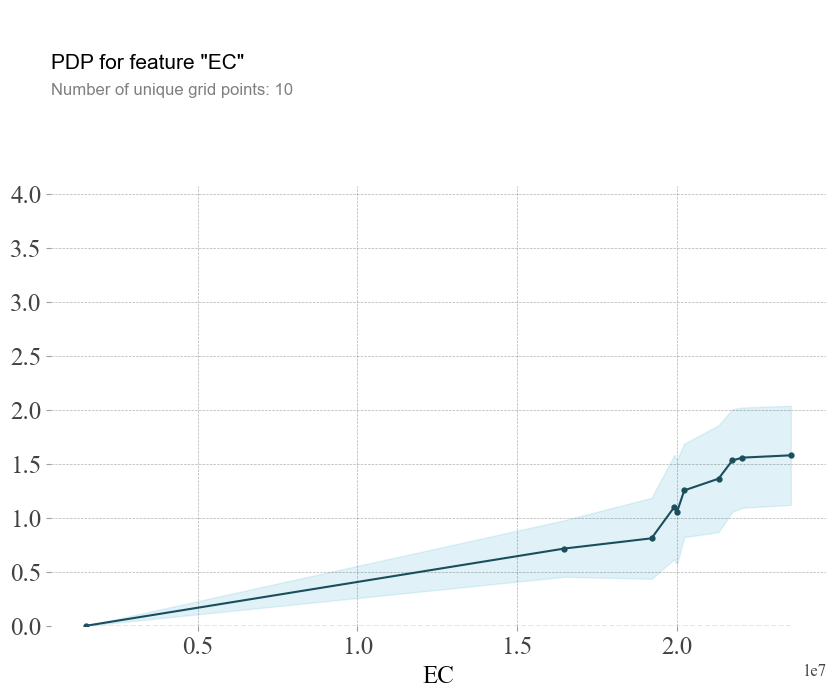

Extracting coordinates of the lines...
Middle Line Coordinates: [(1514227.25, 0.0), (16480972.0, 0.71529007), (19205464.0, 0.809906), (19918418.0, 1.0998306), (20002328.58, 1.0530357), (20230217.0, 1.2541351), (21302846.0, 1.3622742), (21733654.0, 1.5310173), (22051902.0, 1.5575943), (23566934.0, 1.5790672)]
Upper Bound Coordinates: [(1514227.25, 0.0), (1514227.25, 0.0), (16480972.0, 0.9773651659488678), (19205464.0, 1.1849225163459778), (19918418.0, 1.5816982984542847), (20002328.58, 1.5353529751300812), (20230217.0, 1.6872815787792206), (21302846.0, 1.857406198978424), (21733654.0, 2.0058970749378204), (22051902.0, 2.021981120109558), (23566934.0, 2.038542687892914), (23566934.0, 1.119591772556305), (23566934.0, 1.119591772556305), (22051902.0, 1.0932074785232544), (21733654.0, 1.0561375319957733), (21302846.0, 0.8671421408653259), (20230217.0, 0.8209886848926544), (20002328.58, 0.5707184970378876), (19918418.0, 0.6179629564285278), (19205464.0, 0.4348894953727722), (16480972.0, 0.45

In [51]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\EC1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'EC'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected GDP


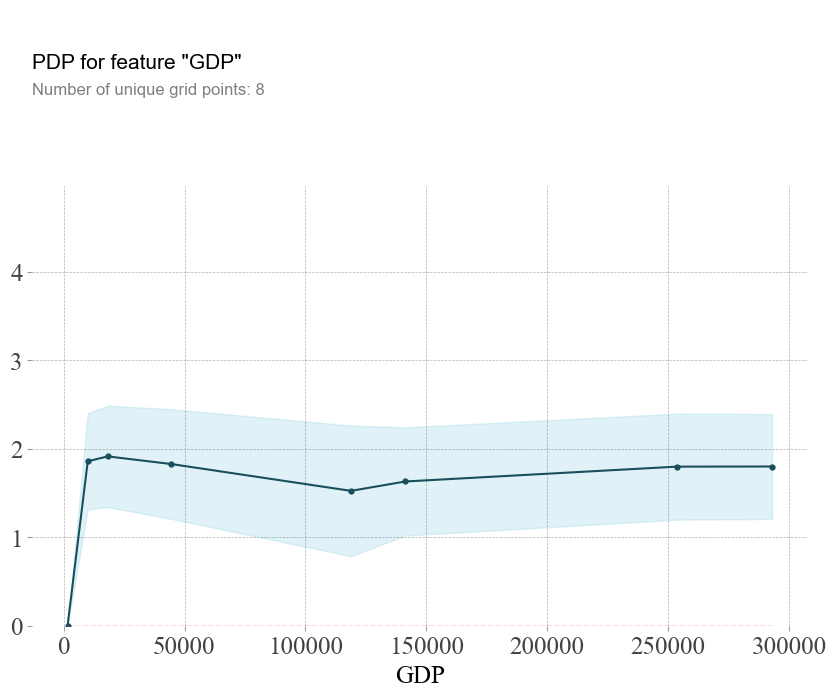

Extracting coordinates of the lines...
Middle Line Coordinates: [(1637.0, 0.0), (9983.0, 1.8594284), (18243.0, 1.9145203), (44591.0, 1.8278427), (118852.678, 1.5249176), (141330.99999999997, 1.6308556), (253720.0, 1.7987251), (293016.0, 1.8002281)]
Upper Bound Coordinates: [(1637.0, 0.0), (1637.0, 0.0), (9983.0, 2.403951644897461), (18243.0, 2.4874358773231506), (44591.0, 2.447989821434021), (118852.678, 2.263221323490143), (141330.99999999997, 2.2424263954162598), (253720.0, 2.397888660430908), (293016.0, 2.3934648633003235), (293016.0, 1.2069913744926453), (293016.0, 1.2069913744926453), (253720.0, 1.199561595916748), (141330.99999999997, 1.019284725189209), (118852.678, 0.7866138815879822), (44591.0, 1.2076956033706665), (18243.0, 1.3416046500205994), (9983.0, 1.3149051666259766), (1637.0, 0.0), (1637.0, 0.0)]
Calculated Lower Bound Coordinates (x same as Middle Line): [(1637.0, 0.0), (9983.0, 3.7188568115234375), (18243.0, 1.425088882446289), (44591.0, 1.1682495474815369), (118852.

In [52]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\GDP1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'GDP'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected SF


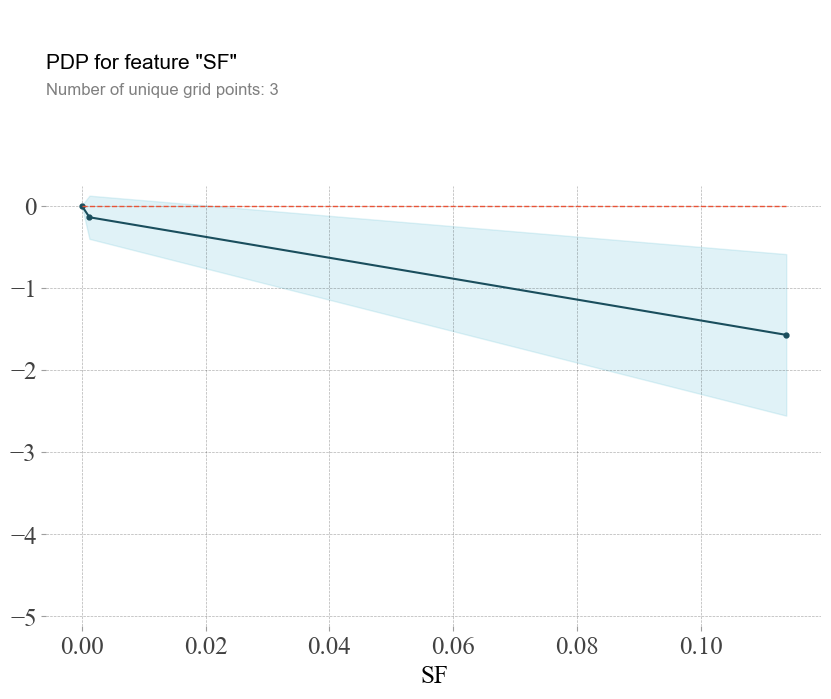

Extracting coordinates of the lines...
Middle Line Coordinates: [(0.0, 0.0), (0.001250068, -0.14191818), (0.113782691, -1.5731812)]
Upper Bound Coordinates: [(0.0, 0.0), (0.0, 0.0), (0.001250068, 0.12096157670021057), (0.113782691, -0.5902235507965088), (0.113782691, -2.556138753890991), (0.113782691, -2.556138753890991), (0.001250068, -0.4047979414463043), (0.0, 0.0), (0.0, 0.0)]
Calculated Lower Bound Coordinates (x same as Middle Line): [(0.0, 0.0), (0.001250068, -0.28383636474609375), (0.113782691, -3.2673238813877106)]
Results saved to confidence_intervals.csv


In [53]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\SF1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'SF'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected FF


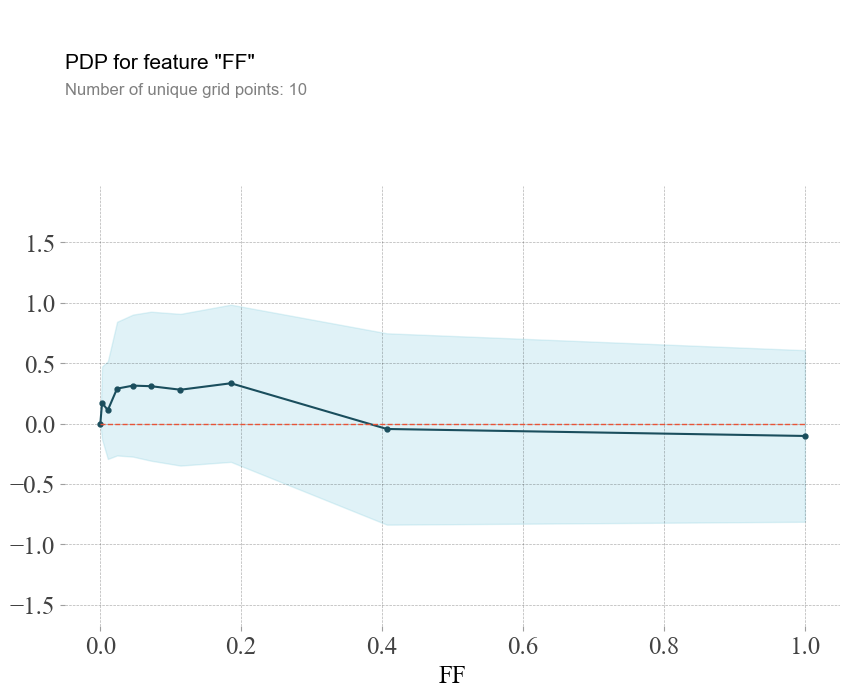

Extracting coordinates of the lines...
Middle Line Coordinates: [(0.0, 0.0), (0.002476942, 0.17119598), (0.010652975, 0.11167145), (0.023769598, 0.28974533), (0.046301381, 0.31460953), (0.071901243, 0.30981445), (0.11377293699999999, 0.28058624), (0.18526335599999996, 0.33415604), (0.406714075, -0.044467926), (0.99999996, -0.10231018)]
Upper Bound Coordinates: [(0.0, 0.0), (0.0, 0.0), (0.002476942, 0.47319650650024414), (0.010652975, 0.516272097826004), (0.023769598, 0.8432120084762573), (0.046301381, 0.9028213620185852), (0.071901243, 0.9269475936889648), (0.11377293699999999, 0.9088013172149658), (0.18526335599999996, 0.9851006269454956), (0.406714075, 0.7480048537254333), (0.99999996, 0.6082976460456848), (0.99999996, -0.8129180073738098), (0.99999996, -0.8129180073738098), (0.406714075, -0.8369407057762146), (0.18526335599999996, -0.31678855419158936), (0.11377293699999999, -0.3476288318634033), (0.071901243, -0.30731868743896484), (0.046301381, -0.27360230684280396), (0.023769598,

In [54]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\FF1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'FF'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected AMMTmax


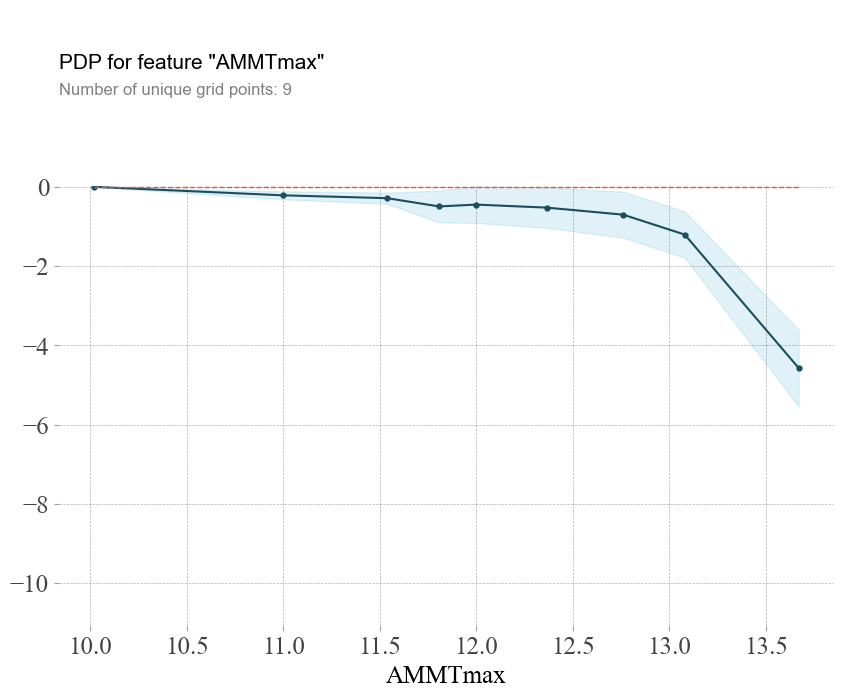

Extracting coordinates of the lines...
Middle Line Coordinates: [(10.01962757, 0.0), (10.99895573, -0.21386719), (11.53823566, -0.2855606), (11.80700646, -0.4941635), (11.99953842, -0.44755554), (12.364706039999998, -0.5239525), (12.76074409, -0.7016182), (13.07992458, -1.2039452), (13.67005444, -4.5701065)]
Upper Bound Coordinates: [(10.01962757, 0.0), (10.01962757, 0.0), (10.99895573, -0.11289846152067184), (11.53823566, -0.14333775639533997), (11.80700646, -0.0941784679889679), (11.99953842, 0.014284312725067139), (12.364706039999998, -0.013814985752105713), (12.76074409, -0.12079036235809326), (13.07992458, -0.6211663484573364), (13.67005444, -3.6030153036117554), (13.67005444, -5.537197709083557), (13.67005444, -5.537197709083557), (13.07992458, -1.7867239713668823), (12.76074409, -1.282446026802063), (12.364706039999998, -1.034089982509613), (11.99953842, -0.9093953967094421), (11.80700646, -0.8941485583782196), (11.53823566, -0.42778345942497253), (10.99895573, -0.31483591347932

In [55]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\AMMTmax1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'AMMTmax'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected AMT


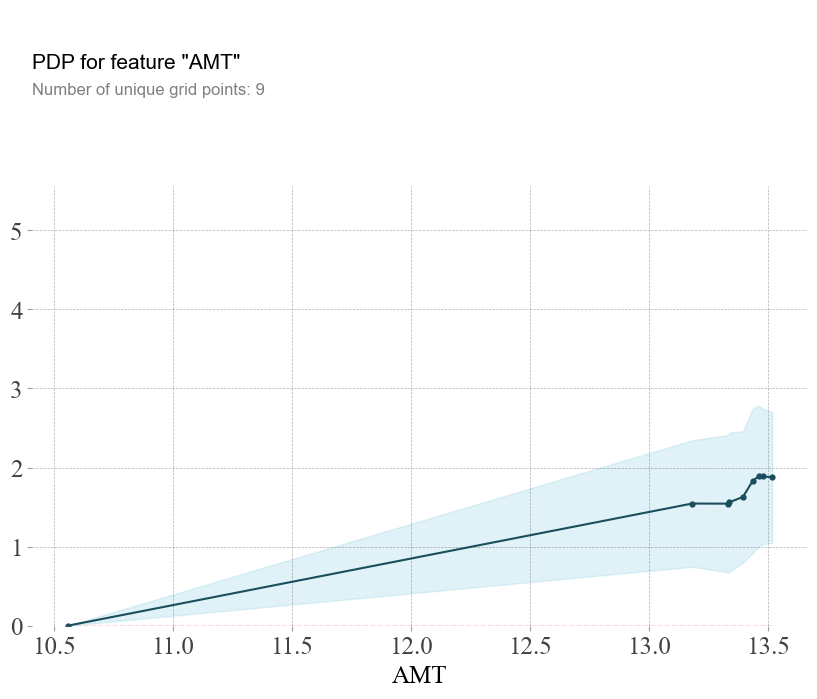

Extracting coordinates of the lines...
Middle Line Coordinates: [(10.55901718, 0.0), (13.17987347, 1.5447273), (13.33246326, 1.5434074), (13.3356287, 1.5599899), (13.39325905, 1.6285591), (13.43364429, 1.8278275), (13.45915127, 1.8908005), (13.47937584, 1.8868217), (13.51571989, 1.8767662)]
Upper Bound Coordinates: [(10.55901718, 0.0), (10.55901718, 0.0), (13.17987347, 2.344297707080841), (13.33246326, 2.4125654697418213), (13.3356287, 2.440630257129669), (13.39325905, 2.459417700767517), (13.43364429, 2.741008996963501), (13.45915127, 2.781603217124939), (13.47937584, 2.7408778071403503), (13.51571989, 2.70385479927063), (13.51571989, 1.0496776103973389), (13.51571989, 1.0496776103973389), (13.47937584, 1.0327656865119934), (13.45915127, 0.9999977350234985), (13.43364429, 0.9146459102630615), (13.39325905, 0.7977005243301392), (13.3356287, 0.6793496012687683), (13.33246326, 0.6742494106292725), (13.17987347, 0.7451569437980652), (10.55901718, 0.0), (10.55901718, 0.0)]
Calculated Lower

In [56]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\AMT1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'AMT'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected RD


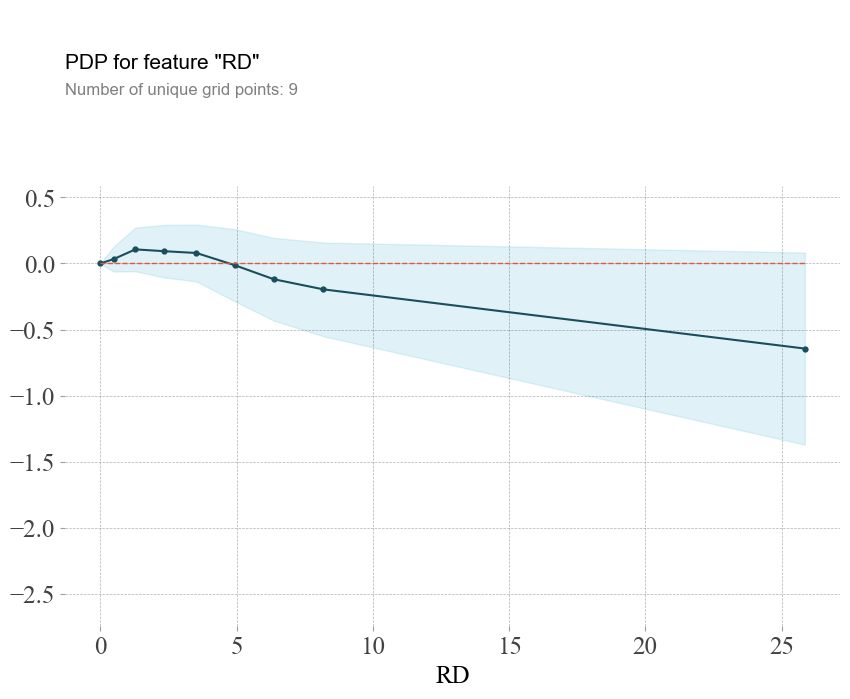

Extracting coordinates of the lines...
Middle Line Coordinates: [(0.0, 0.0), (0.487467192, 0.033081055), (1.2846552789999999, 0.1068306), (2.345363607, 0.09304428), (3.525971869, 0.079559326), (4.93835712, -0.013404846), (6.361410627999999, -0.11912918), (8.18744891, -0.1960907), (25.85132692, -0.64440155)]
Upper Bound Coordinates: [(0.0, 0.0), (0.0, 0.0), (0.487467192, 0.12714550644159317), (1.2846552789999999, 0.2720740884542465), (2.345363607, 0.2917315810918808), (3.525971869, 0.2944938838481903), (4.93835712, 0.2600957453250885), (6.361410627999999, 0.193811297416687), (8.18744891, 0.1586877405643463), (25.85132692, 0.08294367790222168), (25.85132692, -1.3717467784881592), (25.85132692, -1.3717467784881592), (8.18744891, -0.5508691370487213), (6.361410627999999, -0.43206965923309326), (4.93835712, -0.286905437707901), (3.525971869, -0.1353752315044403), (2.345363607, -0.10564301908016205), (1.2846552789999999, -0.05841289460659027), (0.487467192, -0.06098339706659317), (0.0, 0.0),

In [58]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\RD1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'RD'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected MULT


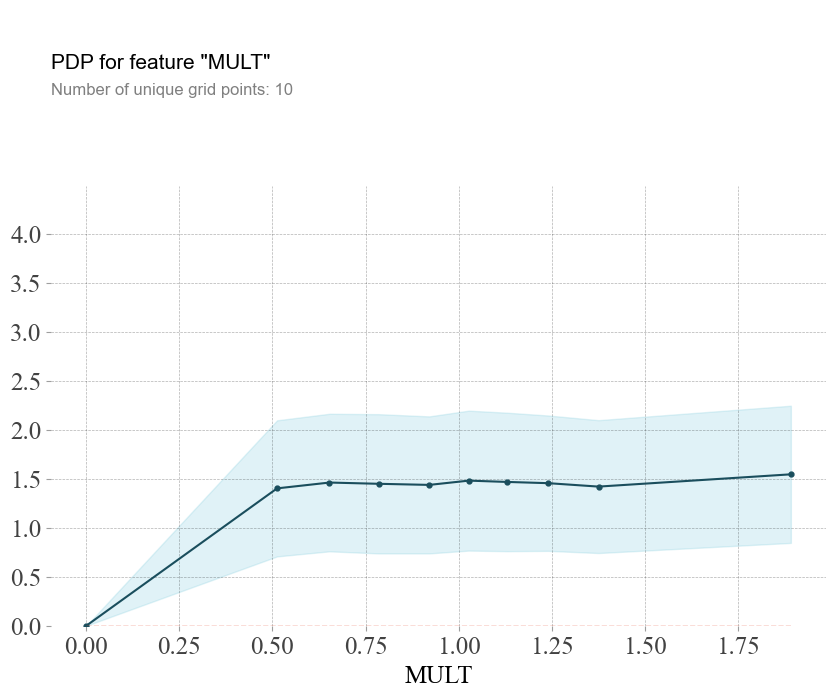

Extracting coordinates of the lines...
Middle Line Coordinates: [(7.27e-07, 0.0), (0.512372524, 1.4025307), (0.653180018, 1.4619789), (0.7850215449999999, 1.4492302), (0.921098157, 1.4379501), (1.027359015, 1.481617), (1.1306720289999999, 1.468193), (1.2408166269999996, 1.4555168), (1.375872168, 1.4206009), (1.892497672, 1.5459709)]
Upper Bound Coordinates: [(7.27e-07, 0.0), (7.27e-07, 0.0), (0.512372524, 2.0973918437957764), (0.653180018, 2.16430801153183), (0.7850215449999999, 2.160155475139618), (0.921098157, 2.1375683546066284), (1.027359015, 2.1961355209350586), (1.1306720289999999, 2.1750696301460266), (1.2408166269999996, 2.146516740322113), (1.375872168, 2.099042057991028), (1.892497672, 2.246431589126587), (1.892497672, 0.8455102443695068), (1.892497672, 0.8455102443695068), (1.375872168, 0.7421597242355347), (1.2408166269999996, 0.7645168900489807), (1.1306720289999999, 0.7613164782524109), (1.027359015, 0.7670984268188477), (0.921098157, 0.7383319139480591), (0.7850215449999

In [59]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\MULT1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'MULT'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected AAS


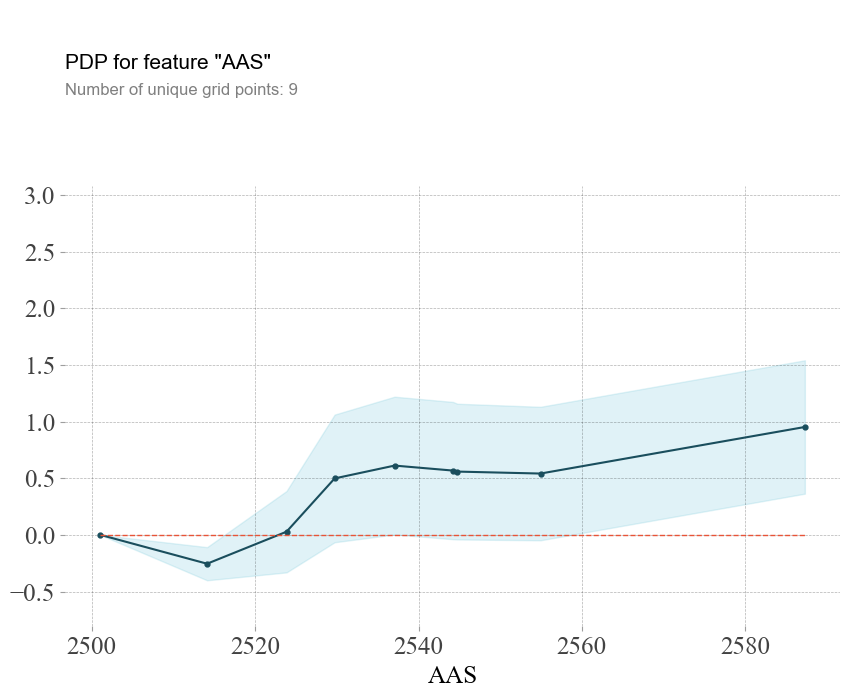

Extracting coordinates of the lines...
Middle Line Coordinates: [(2501.028076, 0.0), (2514.102051, -0.25458527), (2523.831055, 0.028015137), (2529.722046, 0.49804306), (2537.059082, 0.6112938), (2544.218833, 0.56715393), (2544.737305, 0.5582962), (2554.928223, 0.54099274), (2587.300049, 0.95184326)]
Upper Bound Coordinates: [(2501.028076, 0.0), (2501.028076, 0.0), (2514.102051, -0.10837452113628387), (2523.831055, 0.387013703584671), (2529.722046, 1.0611804127693176), (2537.059082, 1.2189508080482483), (2544.218833, 1.1726261973381042), (2544.737305, 1.1570152044296265), (2554.928223, 1.1297762393951416), (2587.300049, 1.5401920080184937), (2587.300049, 0.36349451541900635), (2587.300049, 0.36349451541900635), (2554.928223, -0.0477907657623291), (2544.737305, -0.040422797203063965), (2544.218833, -0.03831833600997925), (2537.059082, 0.003636777400970459), (2529.722046, -0.06509429216384888), (2523.831055, -0.330983430147171), (2514.102051, -0.4007960110902786), (2501.028076, 0.0), (250

In [64]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\AAS1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'AAS'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected ASWR


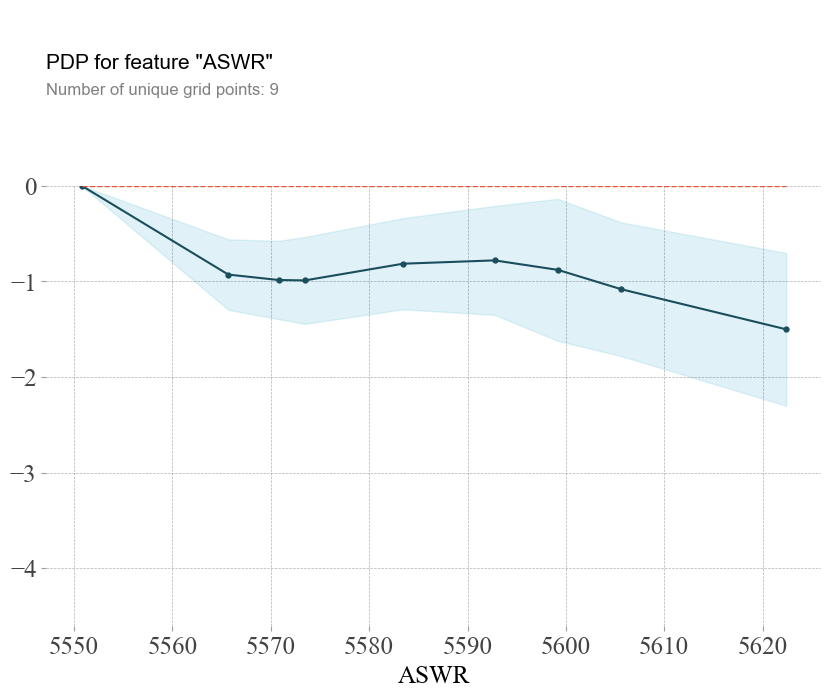

Extracting coordinates of the lines...
Middle Line Coordinates: [(5550.771484, 0.0), (5565.67627, -0.92956924), (5570.778723, -0.9860916), (5573.458984, -0.99061584), (5583.443848, -0.8156662), (5592.748535, -0.78100204), (5599.178223, -0.8802757), (5605.638184, -1.0832748), (5622.393555, -1.5022125)]
Upper Bound Coordinates: [(5550.771484, 0.0), (5550.771484, 0.0), (5565.67627, -0.5609656274318695), (5570.778723, -0.5769781768321991), (5573.458984, -0.5362647771835327), (5583.443848, -0.33869442343711853), (5592.748535, -0.21104562282562256), (5599.178223, -0.1377832293510437), (5605.638184, -0.38412946462631226), (5622.393555, -0.7031201720237732), (5622.393555, -2.301304876804352), (5622.393555, -2.301304876804352), (5605.638184, -1.7824202179908752), (5599.178223, -1.622768223285675), (5592.748535, -1.3509584665298462), (5583.443848, -1.292637974023819), (5573.458984, -1.4449669122695923), (5570.778723, -1.3952050507068634), (5565.67627, -1.2981728613376617), (5550.771484, 0.0), (5

In [42]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\ASWR1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'ASWR'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected DGF


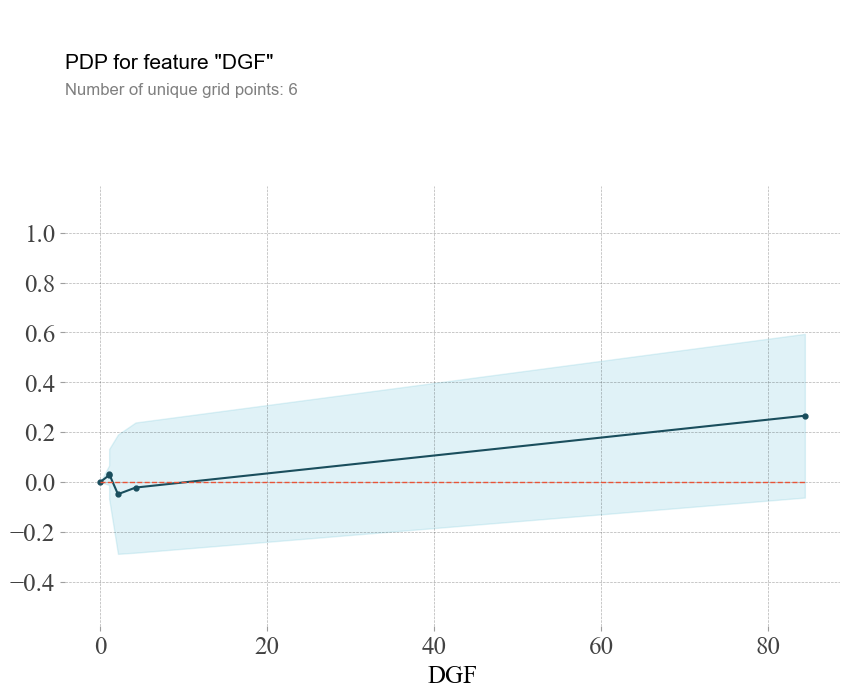

Extracting coordinates of the lines...
Middle Line Coordinates: [(0.0, 0.0), (1.054408982, 0.027263641), (1.057042703, 0.032291412), (2.111961124, -0.049037933), (4.22089477, -0.022449493), (84.42654276, 0.2659912)]
Upper Bound Coordinates: [(0.0, 0.0), (0.0, 0.0), (1.054408982, 0.06657116115093231), (1.057042703, 0.13241424411535263), (2.111961124, 0.19039660692214966), (4.22089477, 0.23882657289505005), (84.42654276, 0.594557136297226), (84.42654276, -0.06257471442222595), (84.42654276, -0.06257471442222595), (4.22089477, -0.2837255597114563), (2.111961124, -0.2884724736213684), (1.057042703, -0.06783141940832138), (1.054408982, -0.012043878436088562), (0.0, 0.0), (0.0, 0.0)]
Calculated Lower Bound Coordinates (x same as Middle Line): [(0.0, 0.0), (1.054408982, 0.05452728271484375), (1.057042703, -0.001988336443901062), (2.111961124, -0.23049011081457138), (4.22089477, -0.2352955937385559), (84.42654276, 0.29315584897994995)]
Results saved to confidence_intervals.csv


In [43]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\DGF1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'DGF'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)

You selected PD


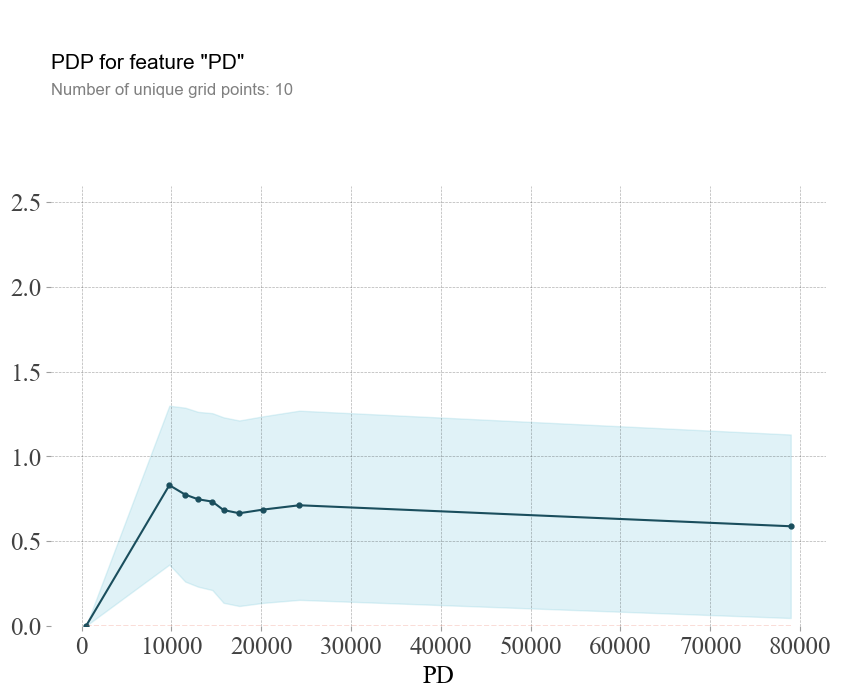

Extracting coordinates of the lines...
Middle Line Coordinates: [(514.5336483, 0.0), (9770.087859, 0.829525), (11538.45929, 0.77366257), (12975.19076, 0.7462387), (14559.46797, 0.73241425), (15804.36945, 0.6826134), (17557.69289, 0.6638298), (20190.58922, 0.6852226), (24248.22394, 0.7109146), (78954.71383, 0.5870056)]
Upper Bound Coordinates: [(514.5336483, 0.0), (514.5336483, 0.0), (9770.087859, 1.2984072268009186), (11538.45929, 1.2868030667304993), (12975.19076, 1.2621793150901794), (14559.46797, 1.2544527053833008), (15804.36945, 1.2299733757972717), (17557.69289, 1.211315631866455), (20190.58922, 1.2357137203216553), (24248.22394, 1.2691909074783325), (78954.71383, 1.1285372972488403), (78954.71383, 0.04547393321990967), (78954.71383, 0.04547393321990967), (24248.22394, 0.15263831615447998), (20190.58922, 0.13473153114318848), (17557.69289, 0.11634397506713867), (15804.36945, 0.13525336980819702), (14559.46797, 0.21037578582763672), (12975.19076, 0.23029810190200806), (11538.45929

In [45]:
from pdpbox import pdp
import matplotlib.pyplot as plt
import pandas as pd

def plot_pdp_and_calculate_bounds(model, df, feature, cluster_flag=False, nb_clusters=None, lines_flag=False):
    # Create the data that we will plot
    pdp_goals = pdp.pdp_isolate(model=model, dataset=df, model_features=df.columns.tolist(), feature=feature)

    # Plot it without 'return_fig' parameter
    fig, ax = pdp.pdp_plot(pdp_goals, feature, cluster=cluster_flag, n_cluster_centers=nb_clusters, plot_lines=lines_flag, figsize=(10, 8))
    
    # 获取当前的matplotlib figure对象
    fig = plt.gcf()
    ax = plt.gca()
    
    # 修改标签字体大小和字体为新罗马
    for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] + ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(18)  # 设置字体大小
        item.set_fontname('Times New Roman')  # 设置字体为新罗马
    
    # 如果存在图例，则也需要修改其字体
    if ax.get_legend() is not None:
        plt.setp(ax.get_legend().get_texts(), fontsize='14')  # 设置图例字体大小
        plt.setp(ax.get_legend().get_texts(), fontname='Times New Roman')  # 设置图例字体为新罗马

    # 保存高质量的图像文件
    plt.savefig('output.png', dpi=1000)
    
    # 显示图像
    plt.show()

    # 提取坐标点
    print("Extracting coordinates of the lines...")
    
    # 获取中间线的坐标点
    mid_line_x = ax.lines[0].get_xdata()
    mid_line_y = ax.lines[0].get_ydata()
    print(f"Middle Line Coordinates: {list(zip(mid_line_x, mid_line_y))}")
    
    upper_bound_x, upper_bound_y = [], []
    lower_bound_y = []  # 初始化下界y坐标列表
    
    if len(ax.collections) > 0:
        upper_bound_path = ax.collections[0].get_paths()[0]
        upper_bound_x = upper_bound_path.vertices[:, 0]
        upper_bound_y = upper_bound_path.vertices[:, 1]
        print(f"Upper Bound Coordinates: {list(zip(upper_bound_x, upper_bound_y))}")
        
        # 计算下界
        for i in range(len(mid_line_x)):
            corresponding_upper_y = upper_bound_y[i] if i < len(upper_bound_y) else None
            if corresponding_upper_y is not None:
                lower_bound_y.append(2 * mid_line_y[i] - corresponding_upper_y)
            else:
                lower_bound_y.append(None)
                
        print(f"Calculated Lower Bound Coordinates (x same as Middle Line): {list(zip(mid_line_x, lower_bound_y))}")

        # 将结果保存到CSV文件
        results_df = pd.DataFrame({
            'Feature_Value': mid_line_x,
            'Middle_Line': mid_line_y,
            'Upper_Bound': upper_bound_y[:len(mid_line_x)],  # 确保长度一致
            'Calculated_Lower_Bound': lower_bound_y
        })
        results_df.to_csv(r'F:\第三篇论文写作\代码出图\PDP合并\PD1.csv', index=False)
        print("Results saved to confidence_intervals.csv")
    else:
        print("No Upper or Lower Bound Lines detected.")

# 假设model和X已经定义
selected_predictor = 'PD'
print('You selected', selected_predictor)
plot_pdp_and_calculate_bounds(model, X, selected_predictor)